# Cats vs Dogs

In [ ]:
# download models on hugging face if you want to run trained models
# these cmd are used in window, if you use linux, change move to mv
# size of this repository: about 453 MB
!git clone https://huggingface.co/AnhQuan003/hddl_cats_dogs
!move hddl_cats_dogs "trained models"

In [ ]:
#then download the dataset for testing models and visualization 
# size: about 800MB
import shutil
import kagglehub
path = kagglehub.dataset_download("aqaq070603/oxford-iiit-pet")
shutil.move(
    path + "/oxford-iiit-pet",
    "../Data/oxford-iiit-pet"
)

# I. Analyse exploratoire 

## 1. Libraries and data

In [23]:
%load_ext autoreload
%autoreload 2
import torch
import torch.nn as nn
from torchvision import transforms
import os
import matplotlib.pyplot as plt 
import matplotlib.image as img

from utils.dataset import CatDogDataset, custom_classifier, custom_segmentation
from utils.analyse import *
from models.model import CatDogClassifier, BreedClassifier, CatDogSegmentation, MultiTaskModel
from utils.train_val import *

from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, random_split
from torch.utils.data import Subset

import torch.nn.functional as F
from torchsummary import summary
import torchinfo
from torchvision import models
import segmentation_models_pytorch as smp
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score,confusion_matrix


import random
import pandas as pd
import albumentations as A
from albumentations.pytorch import ToTensorV2
folder_path = os.path.dirname(os.getcwd())

import seaborn as sns

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")
code_path= os.getcwd()
folder_path = os.path.dirname(os.getcwd())
data_path = os.path.join(folder_path, 'Data','oxford-iiit-pet' )
image_path = os.path.join(data_path, 'images')
mask_path = os.path.join(data_path, 'annotations', 'trimaps')
frame_path = os.path.join(data_path, 'annotations', 'xmls')
logs_path = os.path.join(folder_path, 'Code', 'logs')


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Using device: cuda


<br/><br/><br/>

## 2. Analyse exploratoire 

The oxford-iii-pet contains images of cat and dog, its annotations and bounding boxes. It has 7370 images of 37 breeds of cats and dogs where cat has 12 breeds and dog has 25 breeds.
- Cats: 'Abyssinian', 'Bengal', 'Birman', 'Bombay', 'British Shorthair', 'Egyptian Mau', 'Maine Coon', 'Persian', 'Ragdoll', 'Russian Blue', 'Siamese', 'Sphynx'
- Dogs: 'american bulldog', 'american pit bull terrier', 'basset hound', 'beagle', 'boxer', 'chihuahua', 'english cocker spaniel','havanese', 'japanese chin', 'keeshond', 'leonberger','saint bernard', 'samoyed', 'scottish terrier', 'shiba inu', 'staffordshire bull terrier', 'wheaten terrier', 'yorkshire terrier'

In [24]:
# Check dataset integrity
jpg_files = [f[:-4] for f in os.listdir(image_path) if f.lower().endswith(".jpg")]
xml_files = {f[:-4] for f in os.listdir(frame_path) if f.lower().endswith(".xml")}
mask_files = {f[:-4] for f in os.listdir(mask_path) if f.lower().endswith(".png")}
count_xml = 0
count_mask = 0
for jpg in jpg_files:
    if jpg in xml_files:
        count_xml += 1
    if jpg in mask_files:
        count_mask += 1
print("Total images:", len(jpg_files))
print("Images with matching XML:", count_xml)
print("Images with matching Mask:", count_mask)


Total images: 7390
Images with matching XML: 3686
Images with matching Mask: 7390


That means all images have mask correspondent but about half of them have matching bounding box (we don't use bounding box in this project)

In [26]:
# Import dataset into CatDogClassifier class
catdog_dataset = CatDogDataset(image_path= image_path,mask_path= mask_path, frame_path= frame_path)
len(catdog_dataset)
num_breed = catdog_dataset.num_breed
breed_num = catdog_dataset.breed_num
breeds_mapping = catdog_dataset.breeds_mapping
n_breed = len(pd.unique(catdog_dataset.df_label["breed"]))
dog_breeds = catdog_dataset.df_label[catdog_dataset.df_label["family"]=="dog"]["breed"].unique().tolist()
cat_breeds = catdog_dataset.df_label[catdog_dataset.df_label["family"]=="cat"]["breed"].unique().tolist()

Visualize some samples from the dataset by taking randomly 10 elements from dataset with their mask

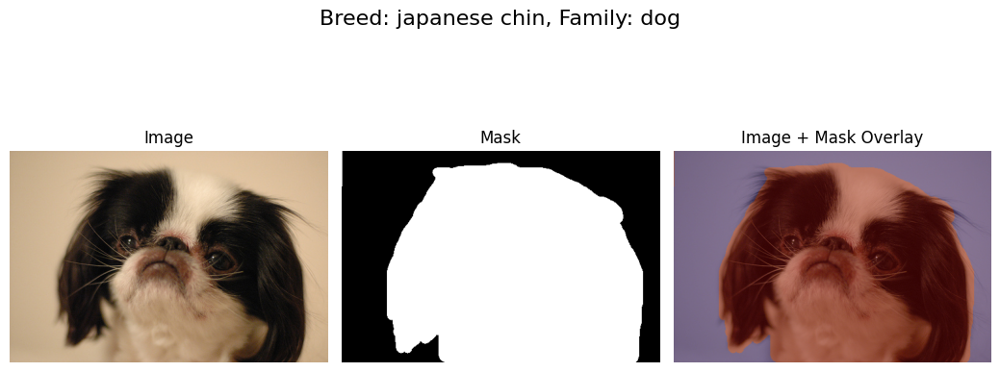

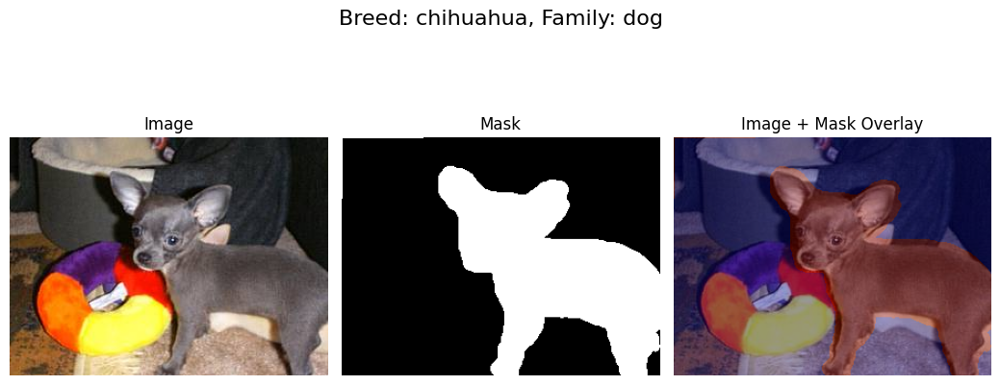

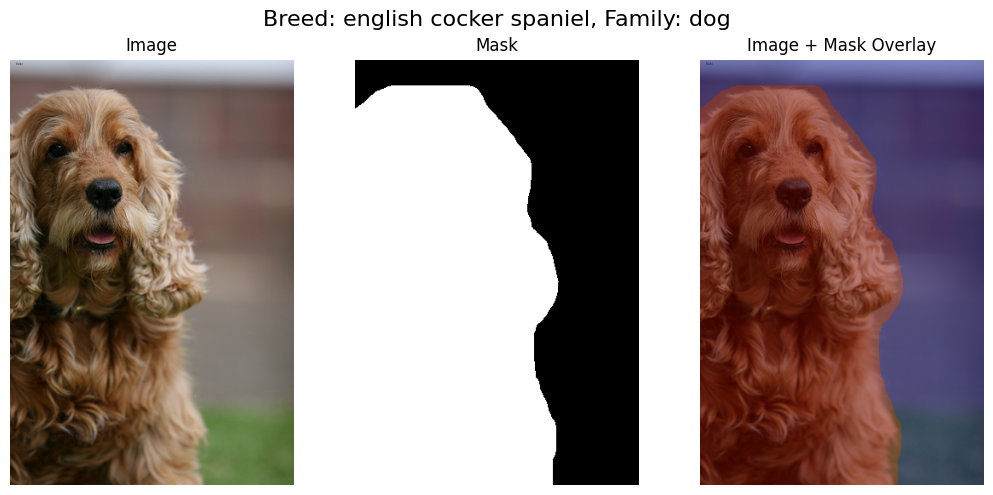

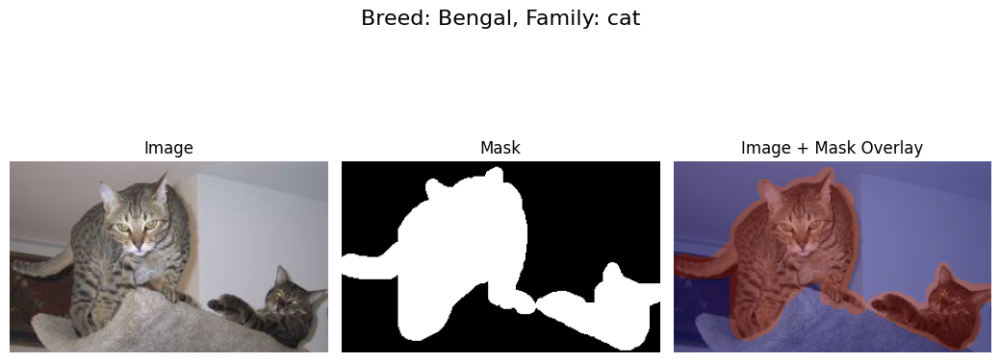

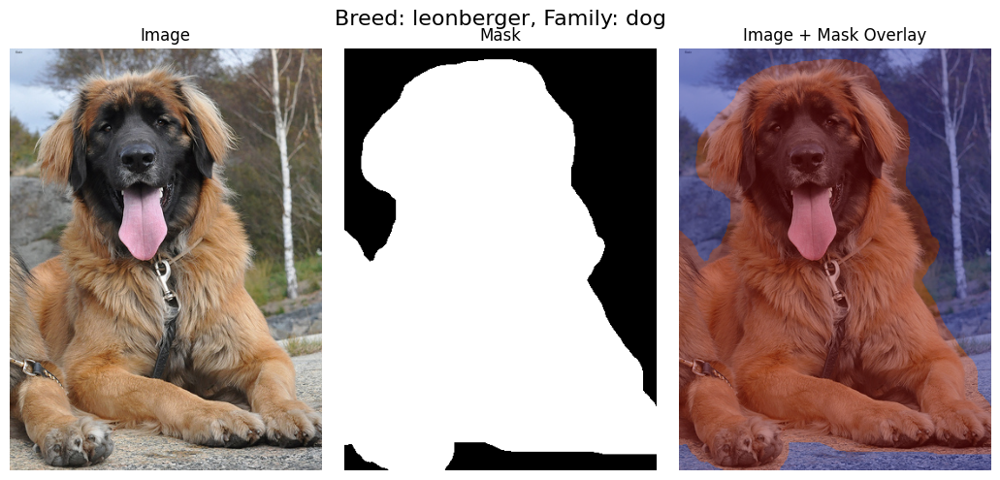

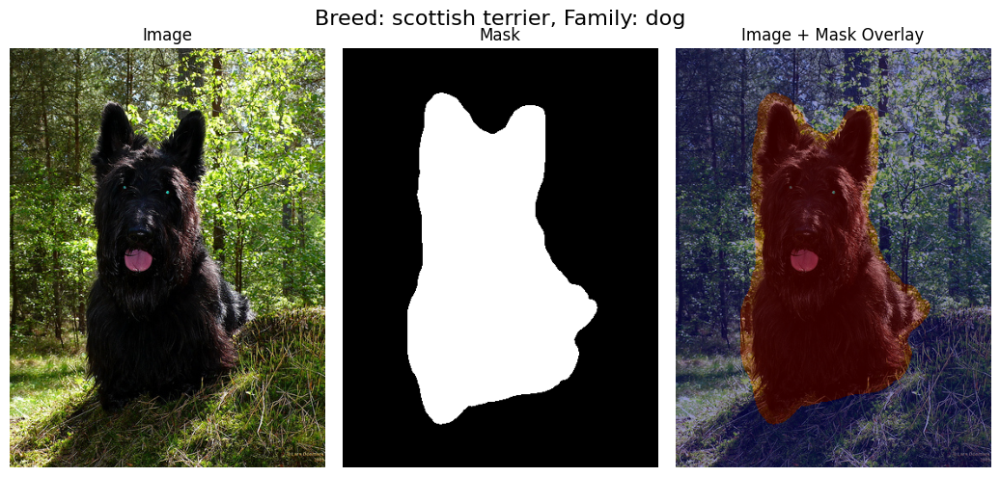

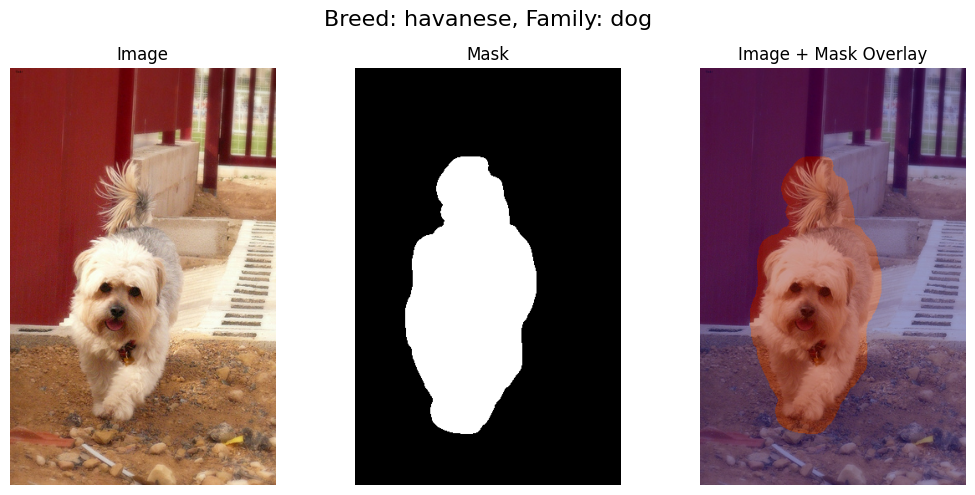

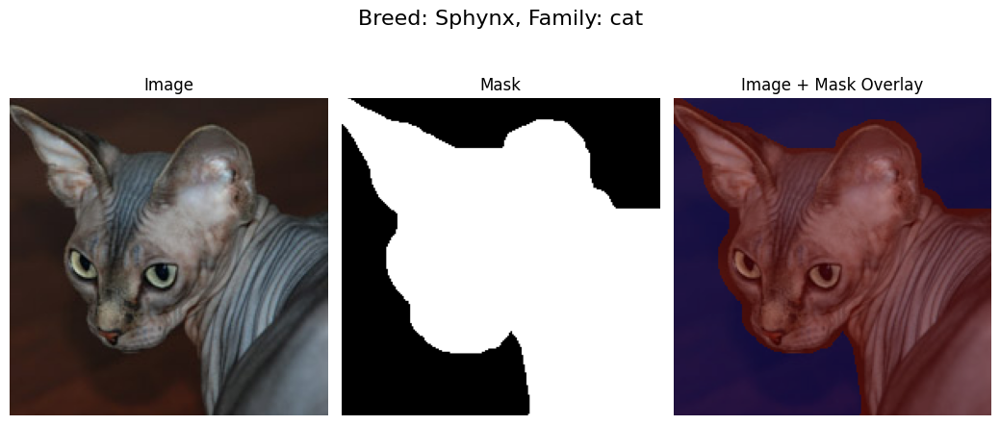

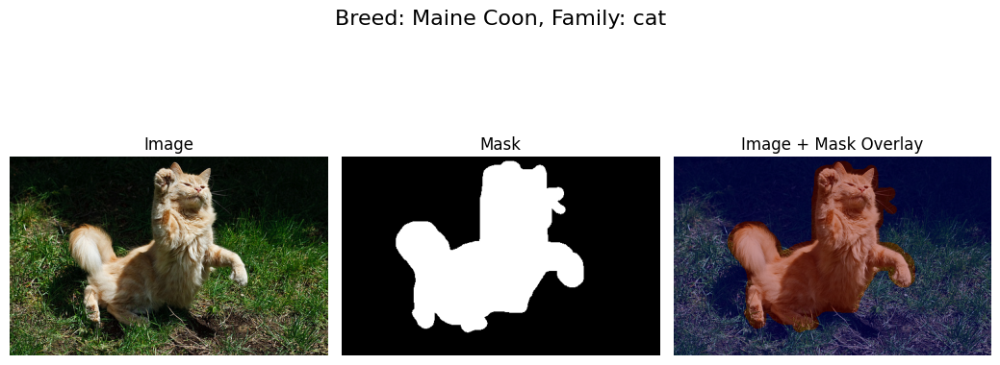

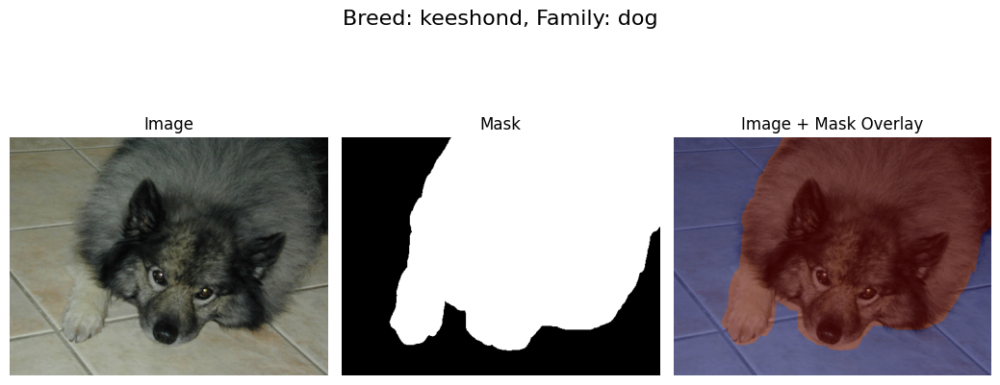

In [11]:
# Visualize some samples from the dataset
for i in range(10):
    show_image(*catdog_dataset[random.randint(0, len(catdog_dataset)-1)])


In the dataset, the segmentation mask contains three values:  
- **1** for the object (cat or dog),  
- **2** for the object border,  
- **3** for the background.  

We merge the object and border classes into a single foreground class labeled **1**, and reassign the background class to **0**, resulting in a binary segmentation mask. We simplify this labeling scheme for the following reasons:

- The objective of our model is **binary animal segmentation** (foreground vs. background), rather than multi-class segmentation (object, border, background). Therefore, we group labels to better align with our task.

- Initial experiments using the original three-class labeling scheme produced unsatisfactory results. This is likely due to the ambiguity and inconsistency of the border class.

- Visual inspection shows that the resulting binary masks closely correspond to the object regions. Although the masks are manually annotated and thus not perfectly accurate, they are sufficiently precise to reliably distinguish the object from the background. Moreover, in most images, the object is centrally located and occupies approximately **40–60%** of the image area, indicating a consistent spatial bias toward centered objects within the dataset.


In [12]:
#from ydata_profiling import ProfileReport
#ProfileReport(catdog_dataset.df_label, sort=None)

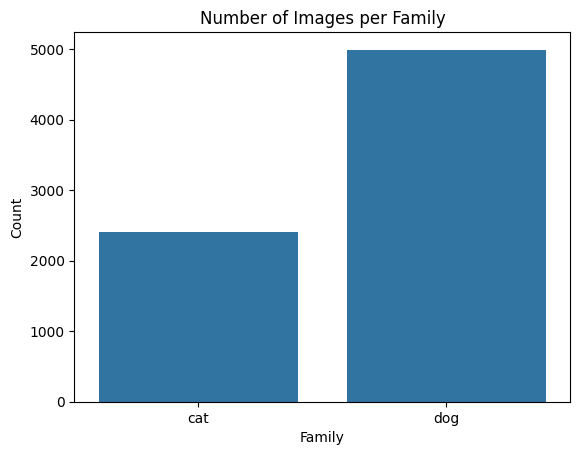

In [ ]:
import seaborn as sns
sns.countplot(data=catdog_dataset.df_label, x='family')
plt.title("Number of Images per Family")
plt.xlabel("Family")
plt.ylabel("Count")
plt.show()

There are about 2500 cat images and 5000 dog images. The number of dog images is twice the number of cat images. We could use a simple augmentation method to increase the number of cat images—perhaps upsampling.

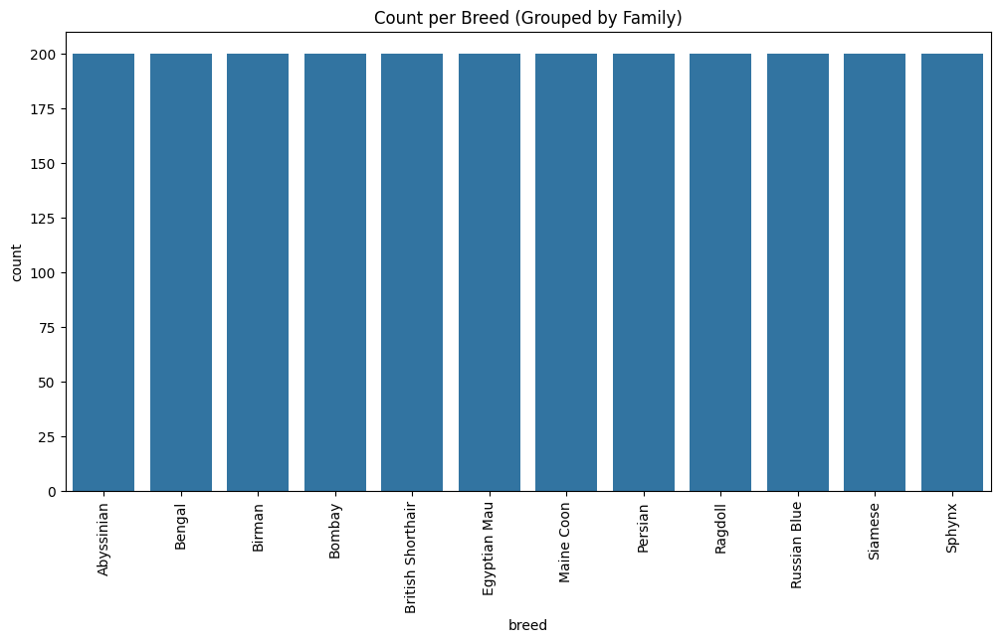

In [47]:
plt.figure(figsize=(12,6))
sns.countplot(data= catdog_dataset.df_label[catdog_dataset.df_label["family"]== "cat"], x='breed')
plt.title("Count per Breed (Grouped by Family)")
plt.xticks(rotation=90)
plt.show()


Each breed has about 200 images. Number of cat's breed images seems very equivalent

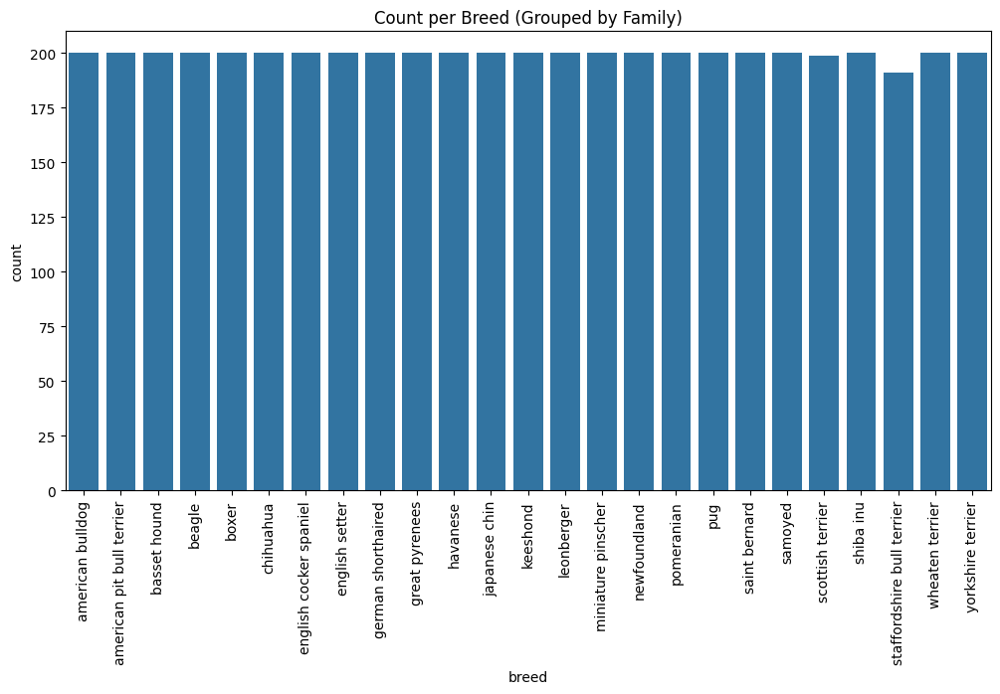

In [48]:
plt.figure(figsize=(12,6))
sns.countplot(data= catdog_dataset.df_label[catdog_dataset.df_label["family"]== "dog"], x='breed')
plt.title("Count per Breed (Grouped by Family)")
plt.xticks(rotation=90)
plt.show()

Number of dog's breed images seems very equivalent too. Each of them has 200 images.

Then we check by visualizing that the images in the same breed have similar colors and patterns or not. 

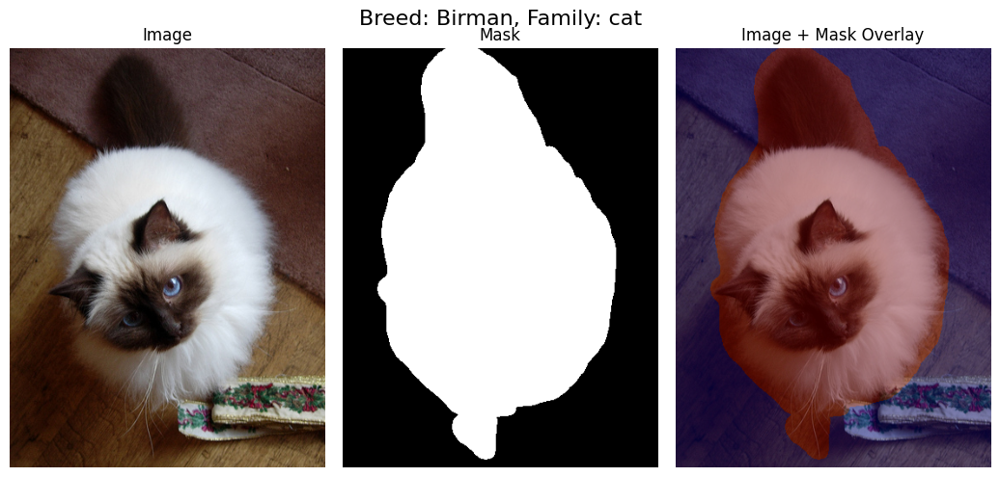

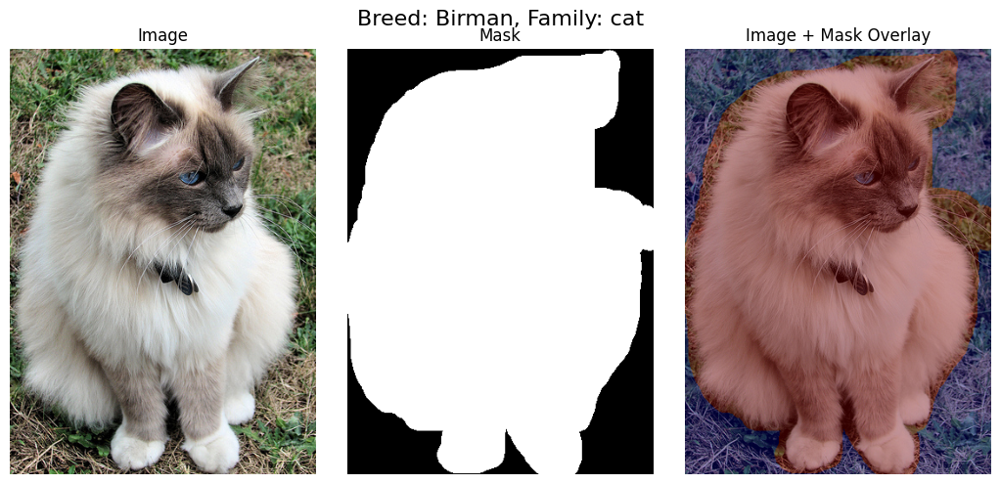

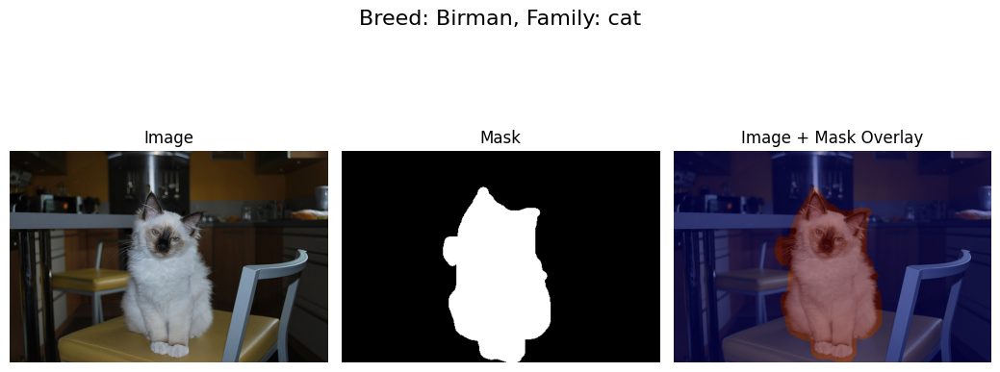

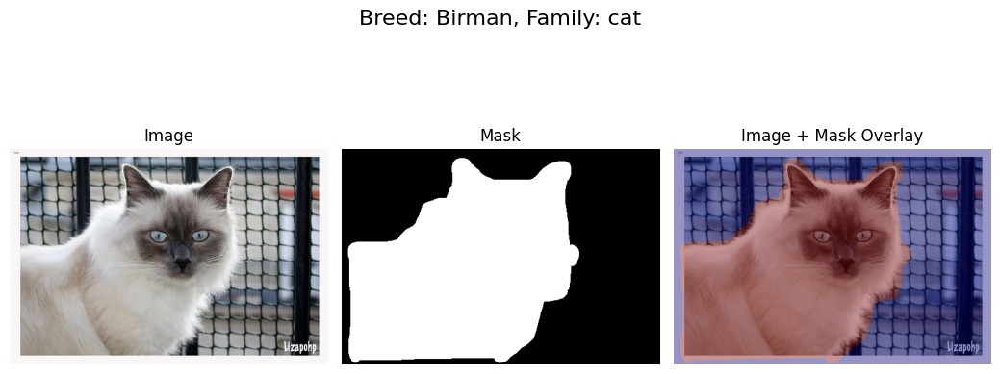

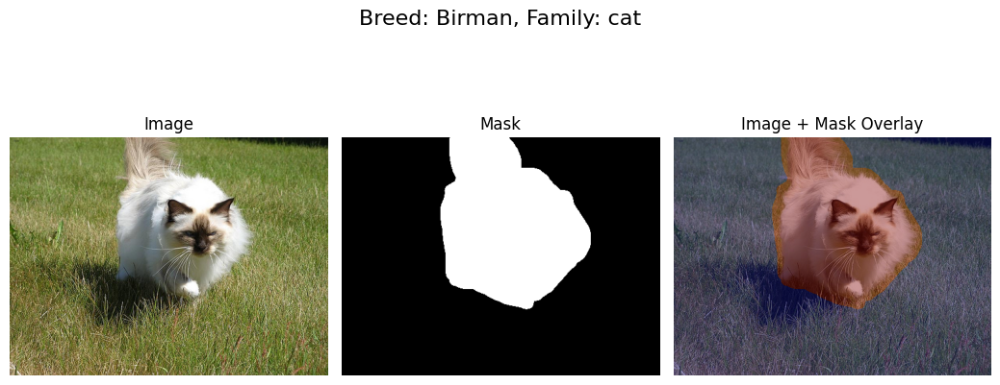

In [22]:
# visualize images from the same breed
breed = 'Birman'
images_idx = catdog_dataset.df_label[catdog_dataset.df_label["breed"]== breed].index.tolist()
for i in range(5):
    show_image(*catdog_dataset[random.choice(images_idx)])

- After checking some breeds, we see that images in the same breed have similar colors and patterns. For example, the Birman cat breed has a distinctive color pattern with a light-colored body and darker points on the ears, face, paws, and tail. The Siberian Husky dog breed is characterized by its thick fur coat, erect triangular ears, and striking blue or multicolored eyes. These consistent features within each breed help in visually identifying them.
- However the brightness and contrast of images in the same breed may vary a lot because of different lighting conditions when taking photos.

<br/><br/><br/>

# II. Classification 

## 1. Preprocessing

In [8]:
"""
# Attention, this cell may take some time to run
information = []

for i in range(len(catdog_dataset)):
    elements = catdog_dataset[i]
    
    info = [elements[0].size[0], elements[0].size[1]]
    if elements[2] is not None:
        info.append(1)
    else:
        info.append(0)
    information.append(info)
information_df =  pd.DataFrame(information, columns=['Height', 'Width', 'Has Bounding Box'])
information_df.to_csv(os.path.join(logs_path, 'image_heights_widths.csv'), index=False)
"""
information_df = pd.read_csv(os.path.join(logs_path, 'image_heights_widths.csv'))
information_df.describe()


,Height,Width,Has Bounding Box
count,7390.000000,7390.000000,7390.000000
mean,436.745196,390.913667,0.498782
std,115.877300,109.586324,0.500032
min,114.000000,103.000000,0.000000
25%,335.000000,333.000000,0.000000
50%,500.000000,375.000000,0.000000
75%,500.000000,500.000000,1.000000
max,3264.000000,2606.000000,1.000000


- There is 7390 images with the average height is 436 and average width is 390. For training models, we will resize all images to 224x224 (this is a common practice in image tasks).
- We will normalize images with mean = [0.5, 0.5, 0.5] and std = [0.5, 0.5, 0.5]. This normalization will scale pixel values to the range [-1, 1], which can help improve model convergence during training.
- For better generalization, we will apply some augmentations such as random horizontal flip, random rotation, and brightness adjustment.

In [32]:
image_size = 224
train_transform = A.Compose(
    [
        A.HorizontalFlip(p=0.5),
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.2, rotate_limit=10, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Resize(image_size, image_size),
        A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
        ToTensorV2()
    ],
    bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']),
)
test_transform = A.Compose(
    [
        A.Resize(image_size, image_size),
        A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
        ToTensorV2()
    ],
    bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']),
)



c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\albumentations\core\validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


We divide the dataset into train and test sets with a 80/20 split. Then, we balance dog cat images in train dataset by up sampling.  Balanced dataset can help improve model performance and reduce bias toward the majority class.

In [10]:
train_catdog = CatDogDataset(image_path, frame_path, mask_path) 
test_catdog = CatDogDataset(image_path, frame_path, mask_path)

df = train_catdog.df_label
indices = list(range(len(df)))
random.shuffle(indices)

train_size = int(0.8 * len(indices))
train_indices = indices[:train_size]
test_indices = indices[train_size:]

# Upsample only train
df_train = df.iloc[train_indices].reset_index(drop=True)
df_cats = df_train[df_train['family'] == 'cat']
df_dogs = df_train[df_train['family'] == 'dog']
cat_dog_ratio = int(len(df_dogs) / len(df_cats))
df_cats_oversampled = pd.concat([df_cats] * cat_dog_ratio, ignore_index=True)
df_train_balanced = pd.concat([df_cats_oversampled, df_dogs], ignore_index=True).reset_index(drop=True)
print(f"Train cat upsampled: {len(df_cats_oversampled)}, train dog (keep inchange): {len(df_dogs)}")
train_catdog.df_label = df_train_balanced
train_catdog.set_transform(train_transform)

test_catdog.df_label = df.iloc[test_indices].reset_index(drop=True)
test_catdog.set_transform(test_transform)
"""
# Verify the transformation
for i in range(5):
    elements = test_dataset[i]
    show_image(image= elements[0].permute(1, 2, 0).numpy(),
               label= elements[1],
               anno= elements[2],
               mask= elements[3])"""

Train cat upsampled: 3804, train dog (keep inchange): 4010


'\n# Verify the transformation\nfor i in range(5):\n    elements = test_dataset[i]\n    show_image(image= elements[0].permute(1, 2, 0).numpy(),\n               label= elements[1],\n               anno= elements[2],\n               mask= elements[3])'

After upsampling, train dataset has 3804 cat images and 4010 dog images. It seems balanced.


<br/><br/><br/>

## 2. Binary classification

### 2.1 Our model

Firstly, we train a cat dog classifier using our model.

In [11]:
# prepare train and test loader 
batch_size = 64
train_catdog_loader = DataLoader(train_catdog, batch_size=batch_size, shuffle=True, collate_fn= custom_classifier)
test_catdog_loader = DataLoader(test_catdog, batch_size=batch_size, shuffle=False, collate_fn= custom_classifier)
print(f"Train dataset size: {len(train_catdog)}")
print(f"Test dataset size: {len(test_catdog)}")


Train dataset size: 7814
Test dataset size: 1478


CatDogClassifier is a simple CNN model with 3 convolutional layers and 2 fully connected layers. We use ReLU activation function and max pooling after each convolutional layer. The output layer has 2 neurons for binary classification (cat or dog).

In [12]:
model = CatDogClassifier().to(device)
summary(model, input_size=(3, image_size, image_size))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 224, 224]             896
       BatchNorm2d-2         [-1, 32, 224, 224]              64
              ReLU-3         [-1, 32, 224, 224]               0
         MaxPool2d-4         [-1, 32, 112, 112]               0
            Conv2d-5         [-1, 64, 112, 112]          18,496
       BatchNorm2d-6         [-1, 64, 112, 112]             128
              ReLU-7         [-1, 64, 112, 112]               0
         MaxPool2d-8           [-1, 64, 56, 56]               0
            Conv2d-9          [-1, 128, 56, 56]          73,856
      BatchNorm2d-10          [-1, 128, 56, 56]             256
             ReLU-11          [-1, 128, 56, 56]               0
        MaxPool2d-12          [-1, 128, 28, 28]               0
AdaptiveAvgPool2d-13            [-1, 128, 1, 1]               0
           Linear-14                   

Then we train this model using train dataset above with CrossEntropyLoss, Adam optimizer and ReduceLROnPlateau scheduler

In [ ]:
# Train model
epochs = 10
lr = 1e-4
criterion = torch.nn.CrossEntropyLoss()
optimizer = Adam(model.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_catdog_classifier(model= model,train_loader= train_catdog_loader, criterion = criterion ,optimizer = optimizer,scheduler = scheduler, epochs = 10, lr= lr )



In [13]:
# Save model
#torch.save(model.state_dict(), f"trained models/catdog_classifier_lr_{lr}_epochs_{epochs}.pth")
# load model
model.load_state_dict(torch.load("trained models/catdog_classifier_lr_0.0001_epochs_10.pth"))

<All keys matched successfully>

Then we evaluate this model on test dataset. For evaluation, we use accuracy, precision, recall, and F1-score as metrics. 

In [ ]:

# Calculate accuracy
model.eval()
pred = []
true = []
with torch.no_grad():
    for images, (_, family) in test_catdog_loader:
        images = images.to(device)
        family = family.to(device)

        outputs = model(images)
        predict = torch.argmax(F.softmax(outputs), 1)
        pred.append(predict)
        true.append(family)
all_preds = torch.cat(pred).cpu().numpy()
all_trues = torch.cat(true).cpu().numpy()

C:\Users\anhqu\AppData\Local\Temp\ipykernel_19920\2959529654.py:13: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  predict = torch.argmax(F.softmax(outputs), 1)


In [ ]:
precision_cat = precision_score(all_trues, all_preds, labels= [0], average='binary', pos_label=0)
recall_cat = recall_score(all_trues, all_preds, labels=[0], average='binary', pos_label=0)
precision_dog = precision_score(all_trues, all_preds, labels= [1], average='binary', pos_label=1)
recall_dog = recall_score(all_trues, all_preds, labels=[1], average='binary', pos_label=1)
accuracy = accuracy_score(all_trues, all_preds)
f1_score_ = f1_score(all_trues, all_preds)
print(f'Accuracy: {accuracy:.2f}')
print(f'Cat Precision: {precision_cat:.2f}, Recall: {recall_cat:.2f}')
print(f'Dog Precision: {precision_dog:.2f}, Recall: {recall_dog:.2f}')
print(f"F1 score: {f1_score_}") 


Accuracy: 0.68
Cat Precision: 0.68, Recall: 0.63
Dog Precision: 0.68, Recall: 0.72
F1 score: 0.7029843675982946


- The model achieves 68% overall accuracy with balanced precision (0.68 for both classes), indicating it's equally confident when predicting cats or dogs. However, there's a performance asymmetry in recall: the model correctly identifies 72% of actual dogs but only 63% of actual cats, suggesting it misses more cats (37%) than dogs (28%). 
- The F1 score of 0.70 reflects this moderate but balanced performance. Overall, this is a decent baseline result showing the model has learned meaningful patterns but struggles more with cat identification, possibly due to the original class imbalance or greater visual variability in cat images. One possible reason for this limitation is that our dataset is not large enough to effectively train the model from scratch.

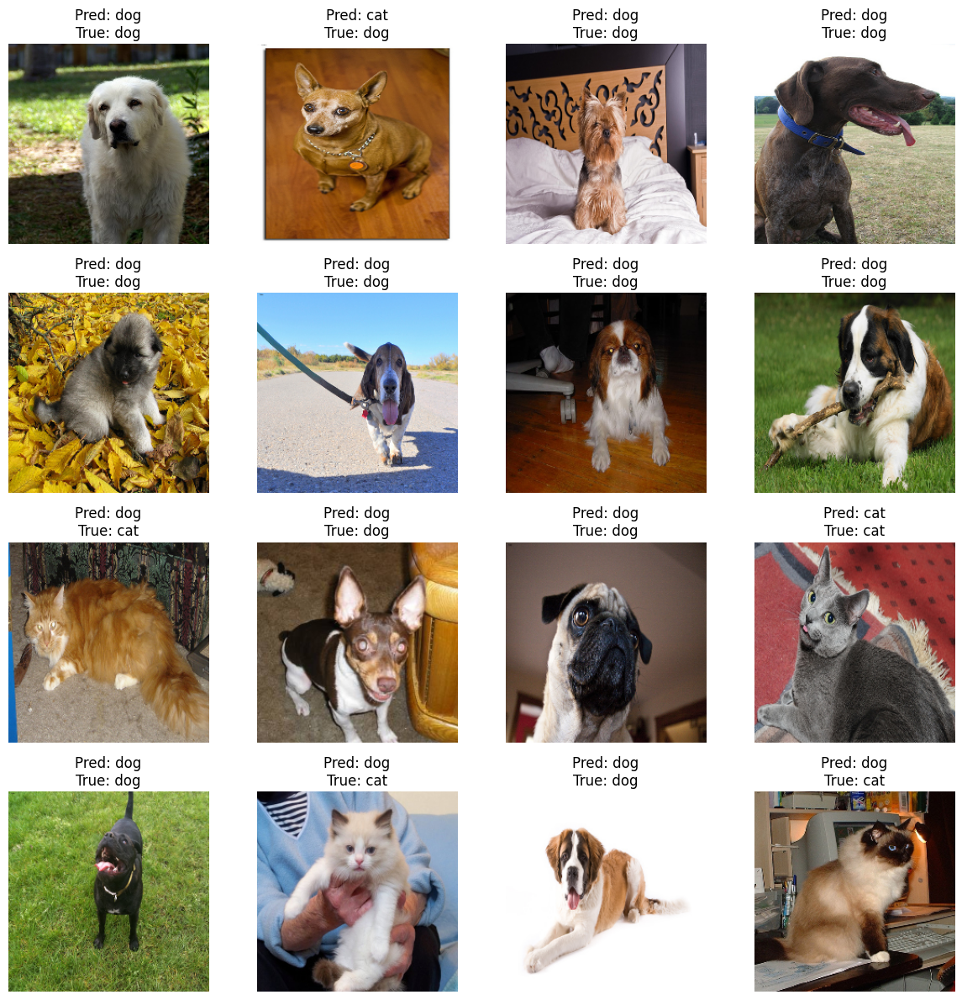

In [ ]:
# Test
display_classification(model, test_catdog_loader, type= "catdog", device= device)

<br/><br/><br/>

### 2.2 Fine-tuning a pretrained model

To address the previous problem, we use a pretrained model- ResNet18. This model is trained on a large dataset, allowing its layers to extract useful and generalizable features.

<img src="images/ResNet-18.png" width="1000">

In [14]:
model_catdog_ft = models.resnet18(pretrained = True).to(device)
summary(model=model_catdog_ft, input_size= (3,224,224))
n_features = model_catdog_ft.fc.in_features
model_catdog_ft.fc = nn.Linear(n_features,2).to(device)

c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,

We examine this model without training on our dataset 

In [225]:
catdog_evaluation(model_catdog_ft, test_catdog_loader)

100%|██████████| 31/31 [00:07<00:00,  4.10it/s]


Accuracy: 0.51
Cat Precision: 0.47, Recall: 0.07
Dog Precision: 0.51, Recall: 0.93
F1 score: 0.6614785992217899


It is essentially a random classifier. The reason is that the model can extract features from animal images, but it doesn’t know how to use these features yet. Therefore, we train the model on our training dataset. To preserve the well-pretrained convolutional layers, we freeze them and train only the final linear layer.

In [ ]:
# Training
for name,params in model_catdog_ft.named_parameters():
    if "fc" not in name:
        params.requires_grad = False
epochs = 10
lr = 1e-4
criterion = torch.nn.CrossEntropyLoss()
optimizer = Adam(model_catdog_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_catdog_classifier(model= model_catdog_ft,train_loader= train_catdog_loader, criterion = criterion ,optimizer = optimizer,scheduler = scheduler, epochs = 10, lr= 1e-4 )

Epoch 10/10 Loss: 0.1126 Learning rate: 0.000100: 100%|██████████| 93/93 [00:32<00:00,  2.88it/s]


In [15]:
#torch.save(model_catdog_ft.state_dict(), f"trained models/model_catdog_ft_lr_{lr}_epochs_{epochs}.pth")
model_catdog_ft.load_state_dict(torch.load("trained models/model_catdog_ft_lr_0.0005_epochs_4.pth"))

<All keys matched successfully>

In [227]:
catdog_evaluation(model_catdog_ft, test_catdog_loader)

100%|██████████| 31/31 [00:07<00:00,  4.11it/s]


Accuracy: 0.97
Cat Precision: 1.00, Recall: 0.94
Dog Precision: 0.95, Recall: 1.00
F1 score: 0.9724504591590141


- The pretrained model achieves excellent performance with 97% accuracy and an F1 score of 0.97, demonstrating strong transfer learning capabilities on the cat-dog classification task. 
- The model shows near-perfect precision for cats (1.00), meaning every image it predicts as a cat is correct, though it miss 6% of actual cats (0.94 recall). Conversely, it identifies all dogs correctly (1.00 recall) but has slightly lower precision (0.95), meaning 5% of its dog predictions are actually cats. This complementary performance pattern—high cat precision with lower recall versus high dog recall with lower precision—suggests the model is slightly conservative when predicting cats but captures all dogs, likely benefiting from rich features representations learned during pretraining that generalize well to this binary classification problem.

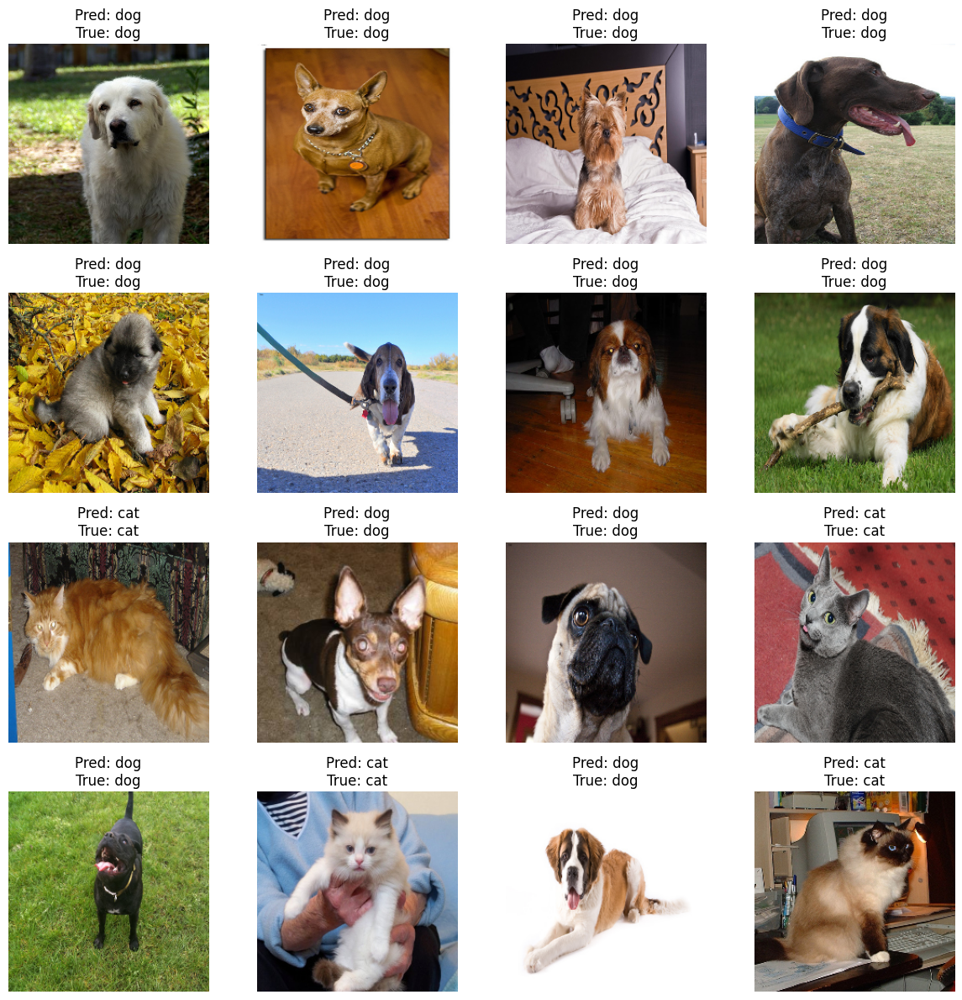

In [ ]:
display_classification(model_catdog_ft, test_catdog_loader, type= "catdog", device= device)

<br/><br/><br/>

## 3. Breed classification 

### 3.1 Our model

Like previous part, we train a breed classifier using our model. In the analyse exploratoire part, we can observe that the images in each breed seem balanced in both cat and dog dataset so we don't need to balance them. BreedClassifier is similar (a little bit deeper in number of channels) to CatDogClassifier but the output layer has 37 neurons for breed classification

In [16]:
model_breed = BreedClassifier(n_breed).to(device)
summary(model_breed, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 224, 224]             896
       BatchNorm2d-2         [-1, 32, 224, 224]              64
              ReLU-3         [-1, 32, 224, 224]               0
            Conv2d-4         [-1, 32, 224, 224]           9,248
              ReLU-5         [-1, 32, 224, 224]               0
            Conv2d-6         [-1, 32, 224, 224]           9,248
       BatchNorm2d-7         [-1, 32, 224, 224]              64
     ResidualBlock-8         [-1, 32, 224, 224]               0
         MaxPool2d-9         [-1, 32, 112, 112]               0
           Conv2d-10        [-1, 128, 112, 112]          36,992
      BatchNorm2d-11        [-1, 128, 112, 112]             256
             ReLU-12        [-1, 128, 112, 112]               0
           Conv2d-13        [-1, 128, 112, 112]         147,584
             ReLU-14        [-1, 128, 1

In [33]:
train_dataset = CatDogDataset(image_path, frame_path, mask_path) 
train_dataset.set_transform(train_transform)
test_dataset = CatDogDataset(image_path, frame_path, mask_path)
test_dataset.set_transform(test_transform)

indices = list(range(len(train_dataset)))
random.shuffle(indices)  


train_size = int(0.8 * len(indices))
train_indices = indices[:train_size]
test_indices = indices[train_size:]

train_dataset = Subset(train_dataset, train_indices)
test_dataset = Subset(test_dataset, test_indices)

batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn= custom_classifier)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn= custom_classifier)

In [ ]:
epochs = 4
lr = 5e-4
criterion = torch.nn.CrossEntropyLoss() 
optimizer = Adam(model_breed.parameters(), lr=lr, weight_decay=1e-6)
scheduler = model_breed(optimizer, mode='min', factor=0.5, patience=2)
train_breed_classifier(model_breed,train_loader, criterion,optimizer,scheduler, catdog_dataset.get_breed_num, epochs = epochs, lr= lr, device = "cuda" )

Epoch 1/1 Loss: 3.2448 Learning rate: 0.000500: 100%|██████████| 93/93 [28:47<00:00, 18.58s/it]


In [17]:
#torch.save(model_breed.state_dict(), f"trained models/model_breed_lr_{lr}_epochs_{epochs}.pth")
model_breed.load_state_dict(torch.load("trained models/model_breed_lr_0.0005_epochs_4.pth"))

<All keys matched successfully>

c:\Users\anhqu\Desktop\Anh Quan\hddl_project_2025\Code\utils\analyse.py:59: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  probs = F.softmax(outputs)


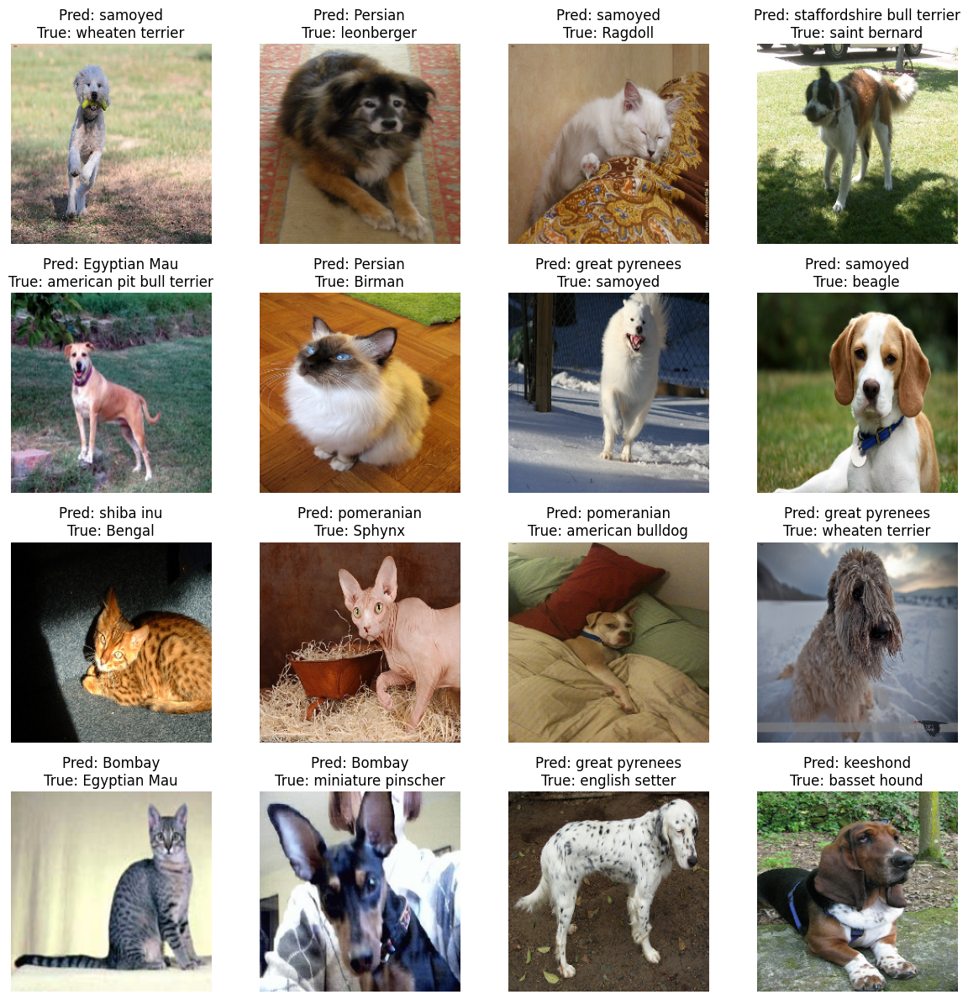

In [ ]:
# Test
display_classification(model_breed, test_loader, num_breed, type= "breed", device= device)

100%|██████████| 24/24 [00:29<00:00,  1.24s/it]


Accuracy: 0.12


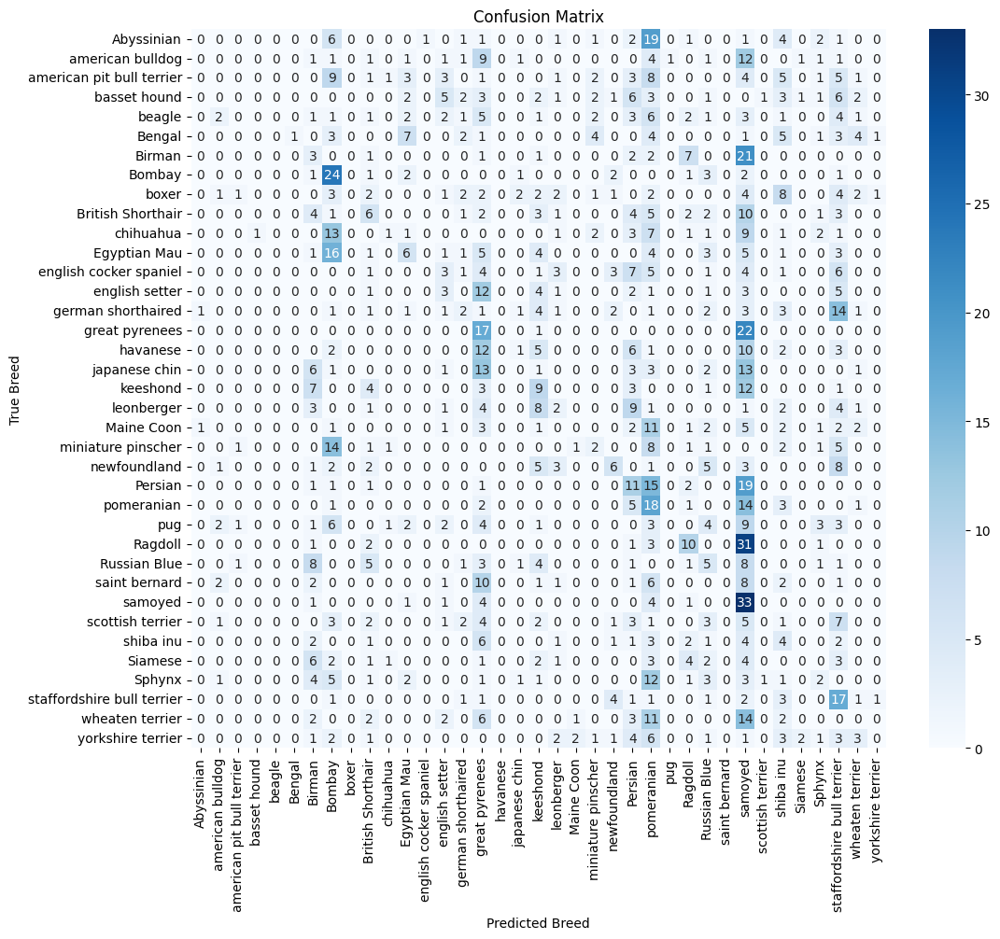

=== TOP 5 MOST CONFUSED BREED PAIRS ===
Ragdoll -> samoyed: 31 times
great pyrenees -> samoyed: 22 times
Birman -> samoyed: 21 times
Persian -> samoyed: 19 times
Abyssinian -> pomeranian: 19 times

=== EASILY DETECTED (Top 5) ===
                     breed  f1_score  precision   recall  support
                    Bombay  0.305732   0.201681 0.631579     38.0
                   Ragdoll  0.229885   0.263158 0.204082     49.0
staffordshire bull terrier  0.225166   0.145299 0.500000     34.0
              newfoundland  0.203390   0.272727 0.162162     37.0
                   samoyed  0.189655   0.108911 0.733333     45.0

=== HARDLY DETECTED (Bottom 5) ===
            breed  f1_score  precision  recall  support
              pug       0.0        0.0     0.0     42.0
          Siamese       0.0        0.0     0.0     30.0
 scottish terrier       0.0        0.0     0.0     36.0
  wheaten terrier       0.0        0.0     0.0     43.0
yorkshire terrier       0.0        0.0     0.0     34.0


In [53]:
breed_evaluation(model_breed, test_loader, breed_num, num_breed)

With an accuracy of 0.12, some breed like pug, siammese,... has 0 for precision and recall, the model shows poor performance when trained from scratch. There are two main reasons for this:
- First, our dataset is very limited, with only 200 images per breed, which is insufficient to train a deep model effectively from scratch. Deep learning models typically require large amounts of data to learn robust features, and with such a small dataset, the model likely overfits to the training data and fails to generalize well to unseen images.
- Second, classifying 1 out of 37 breeds is a much more challenging task. It is no longer a binary classification problem and is significantly more complex than the cat–dog classification discussed earlier. This task requires a very deep model and many hours of training. Although our model was trained for about one hour and is deeper than the cat–dog classifier, this still appears to be insufficient.

<br/><br/><br/>

### 3.2 Fine-tuning a pretrained model

Like previous part, we will use a pretrained model- efficientnet_b3. EfficientNet is a powerful architecture that has been pre-trained on a large dataset, making it suitable for transfer learning tasks. I added some linear layers in the end of efficientnet_b3 to strengthen the classifier block

<img src="images/efficientnetb3.png" width="1000">

MB Convolution is a type of convolutional layer used in EfficientNet architectures. MB stands for "Mobile Bottleneck," which is designed to reduce the number of parameters and computational cost while maintaining performance. It does this by using depthwise separable convolutions and pointwise convolutions, allowing the model to be more efficient and lightweight.

In [28]:
model_breed_ft = models.efficientnet_b3(pretrained = True).to(device)
print(model_breed_ft)
n_features = model_breed_ft.classifier[1].in_features
model_breed_ft.classifier = nn.Sequential(
    nn.Dropout(0.3, inplace=True),
    nn.Linear(n_features, 512), nn.ReLU(inplace=True),
    nn.Linear(512,128), nn.ReLU(inplace=True),
    nn.Dropout(0.3),
    nn.Linear(128, n_breed)
).to(device)

c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B3_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=40, bias=False)
            (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(40, 10, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(10, 40, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActiv

In [232]:
for param in model_breed_ft.parameters():
    param.requires_grad = False

for param in model_breed_ft.classifier.parameters():
    param.requires_grad = True
epochs = 4
lr = 5e-4
criterion = torch.nn.CrossEntropyLoss() 
optimizer = Adam(model_breed_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_breed_classifier(model_breed_ft,train_loader, criterion,optimizer,scheduler, catdog_dataset.get_breed_num, epochs = epochs, lr= lr, device = "cuda" )

Epoch 4/4 Loss: 0.7760 Learning rate: 0.000500: 100%|██████████| 93/93 [03:17<00:00,  2.12s/it]


In [29]:
#torch.save(model_breed_ft.state_dict(), f"trained models/model_breed_ft_lr_{lr}_epochs_{epochs}.pth")
model_breed_ft.load_state_dict(torch.load("trained models/model_breed_ft_lr_0.0005_epochs_4.pth"))

<All keys matched successfully>

100%|██████████| 24/24 [00:06<00:00,  3.55it/s]


Accuracy: 0.88


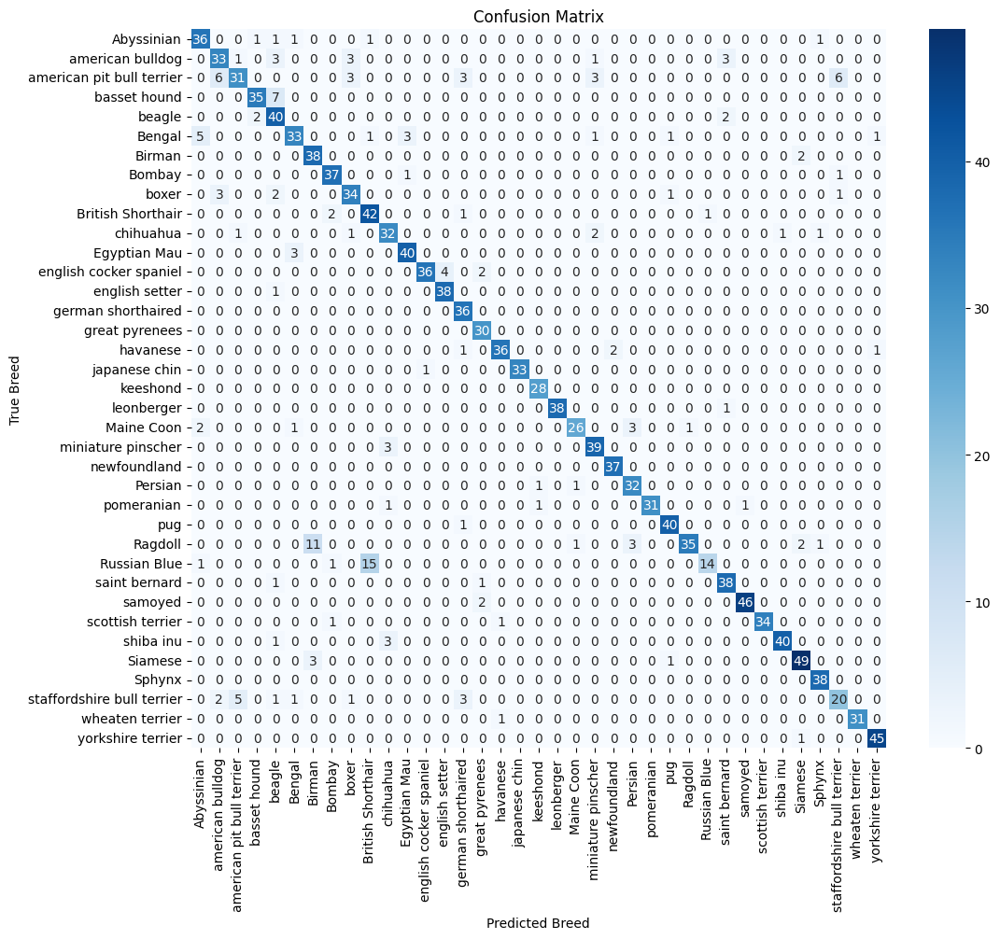

=== TOP 5 MOST CONFUSED BREED PAIRS ===
Russian Blue -> British Shorthair: 15 times
Ragdoll -> Birman: 11 times
basset hound -> beagle: 7 times
american pit bull terrier -> staffordshire bull terrier: 6 times
american pit bull terrier -> american bulldog: 6 times

=== EASILY DETECTED (Top 5) ===
           breed  f1_score  precision   recall  support
      leonberger  0.987013   1.000000 0.974359     39.0
   japanese chin  0.985075   1.000000 0.970588     34.0
 wheaten terrier  0.984127   1.000000 0.968750     32.0
    newfoundland  0.973684   0.948718 1.000000     37.0
scottish terrier  0.971429   1.000000 0.944444     36.0

=== HARDLY DETECTED (Bottom 5) ===
                     breed  f1_score  precision   recall  support
                    Bengal  0.785714   0.846154 0.733333     45.0
          american bulldog  0.750000   0.750000 0.750000     44.0
 american pit bull terrier  0.688889   0.815789 0.596154     52.0
staffordshire bull terrier  0.655738   0.714286 0.606061     33.0
 

In [35]:
breed_df_classification = breed_evaluation(model_breed_ft, test_loader, breed_num= breed_num, num_breed= num_breed)

The breed classification results reveal distinct patterns of model performance and confusion. 
- The model excels at identifying visually distinctive breeds like Keeshond, Yorkshire Terrier, and Japanese Chin (F1 scores ~0.94-0.97), which likely have unique features such as specific coat textures, colors, or body structures. 
- However, model struggles significantly with visually similar breeds, particularly among cats and bull terrier types. The most problematic confusion is Russian Blue being misclassified as British Shorthair 20 times, resulting in Russian Blue having the worst performance (F1: 0.41, recall: 0.28)—the model misses 72% of Russian Blues. Similarly, Staffordshire Bull Terriers and American Pit Bull Terriers are frequently confused with each other (20 misclassifications combined), both achieving poor F1 scores around 0.53-0.54. The Ragdoll-Birman confusion among long-haired cats and the English Cocker Spaniel-English Setter confusion among spaniels further demonstrate that the model struggles with breeds sharing similar morphological characteristics, suggesting that more discriminative features or additional training data for these similar breed pairs would be needed to improve performance.

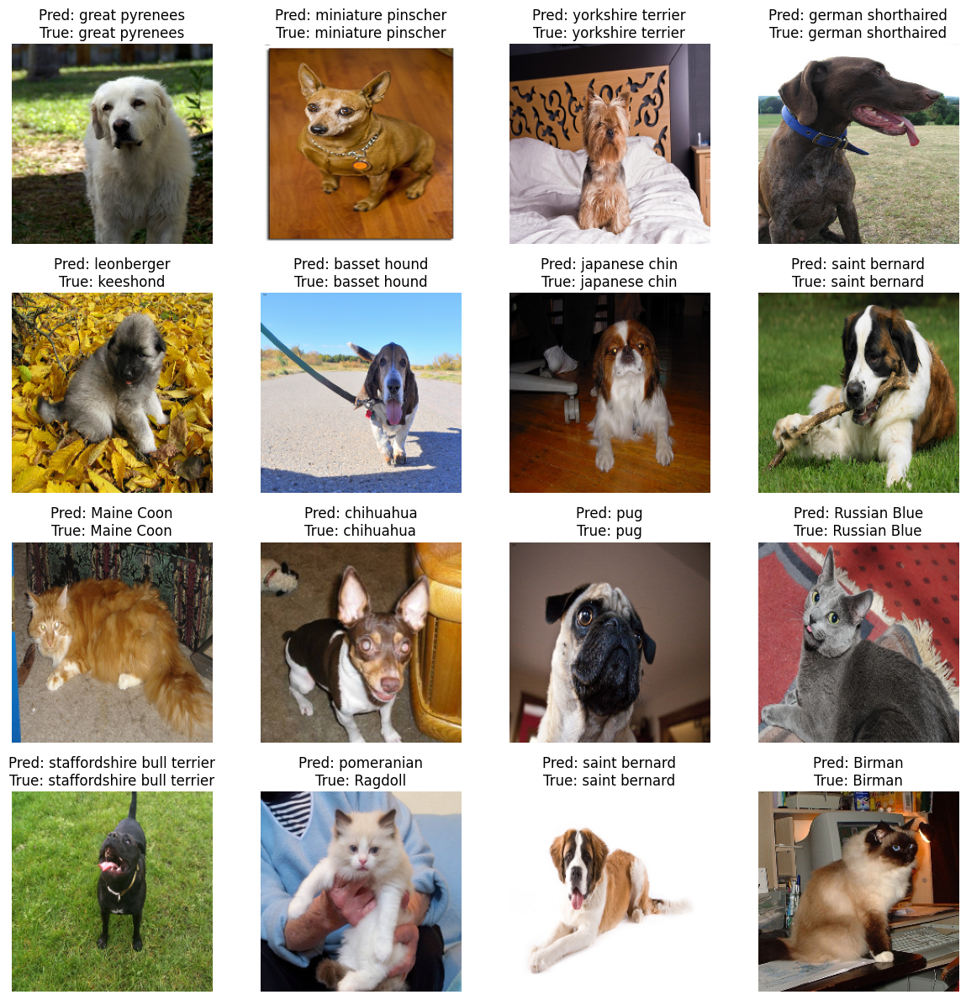

In [ ]:
# visualize some results 
display_classification(model_breed_ft, test_loader, num_breed, type= "breed", device= device)

<br/><br/><br/>

# III. Segmentation

## 1. Segmentation with U-Net

### 1.1. U-net from scratch

In [51]:
batch_size = 16
train_seg_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn= custom_segmentation)
test_seg_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn= custom_segmentation)

CatDogSegmentation is a U-net model with encoder and decoder blocks. Encoder and decoder consist of 3 conv bloc, each conv bloc has 2 convolutional layers with ReLU activation function. In encoder, we use max pooling to downsample the feature maps while in decoder, we use transposed convolution to upsample the feature maps. he code of model is save in `models/model.py`

In [52]:
model_seg = CatDogSegmentation().to(device)
summary(model_seg, (3,224,224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 224, 224]             896
              ReLU-2         [-1, 32, 224, 224]               0
            Conv2d-3         [-1, 32, 224, 224]           9,248
              ReLU-4         [-1, 32, 224, 224]               0
         MaxPool2d-5         [-1, 32, 112, 112]               0
            Conv2d-6         [-1, 64, 112, 112]          18,496
              ReLU-7         [-1, 64, 112, 112]               0
            Conv2d-8         [-1, 64, 112, 112]          36,928
              ReLU-9         [-1, 64, 112, 112]               0
        MaxPool2d-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 128, 56, 56]          73,856
             ReLU-12          [-1, 128, 56, 56]               0
           Conv2d-13          [-1, 128, 56, 56]         147,584
             ReLU-14          [-1, 128,

In [89]:
epochs = 8
lr = 5e-4
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model_seg.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_unet(model_seg, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)

Epoch 8/8 Loss: 0.2357 Learning rate: 0.000500: 100%|██████████| 370/370 [01:24<00:00,  4.40it/s]


In [53]:
#torch.save(model_seg.state_dict(), f"trained models/model_segmentation_lr_{lr}_epochs_{epochs}.pth")
model_seg.load_state_dict(torch.load("trained models/model_segmentation_lr_0.0005_epochs_8.pth"))

<All keys matched successfully>

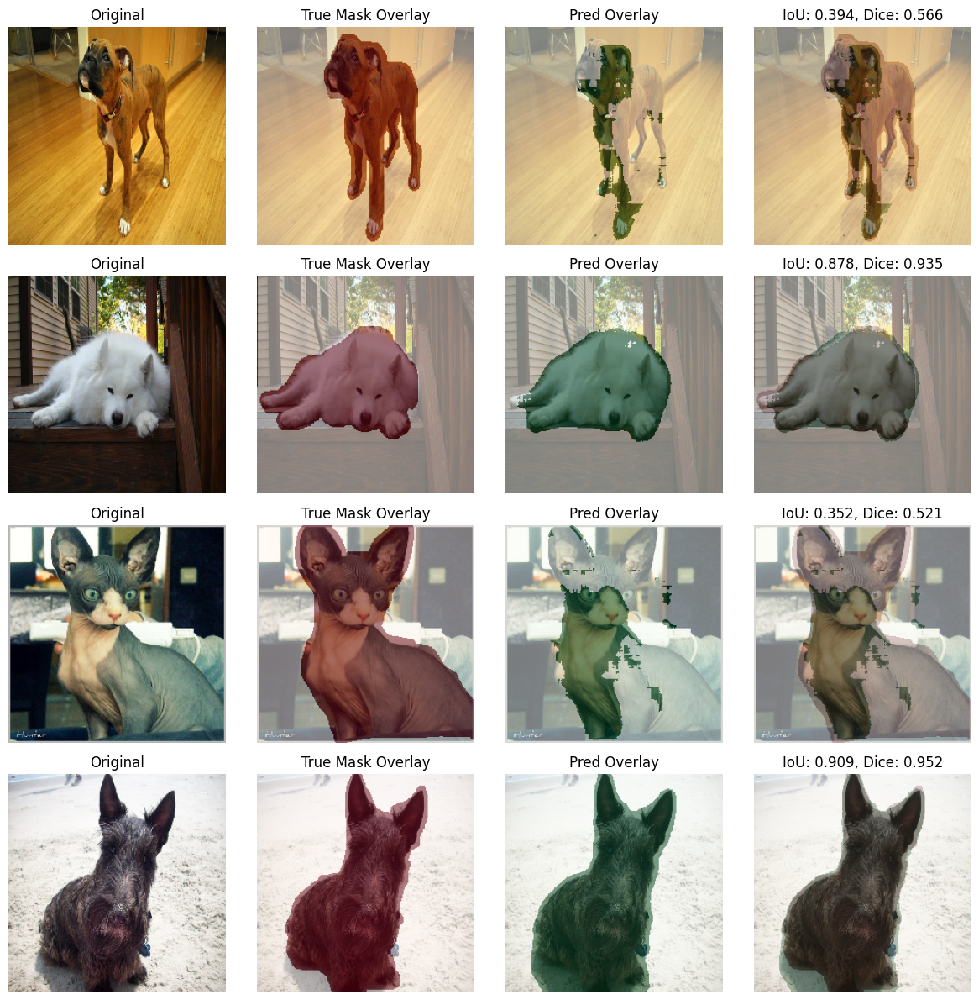

In [60]:
display_segmentation(model_seg, test_seg_loader)

In [54]:
segmentation_results_scratch = evaluate_segmentation(model_seg, test_seg_loader)

100%|██████████| 93/93 [00:23<00:00,  4.04it/s]


In [55]:
family_metrics_seg_scratch = segmentation_results_scratch.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg_scratch = segmentation_results_scratch.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()


In [57]:
show_table(family_metrics_seg_scratch, "Family Segmentation Metrics")
show_table(breed_metrics_seg_scratch, "Breed Segmentation Metrics")

- Through visualization, we observe that the model trained from scratch performs reasonably well, as it can clearly distinguish the object from the background. 
- The segmentation model demonstrates strong overall performance, with mean IoU scores of 0.64 for cats and 0.68 for dogs, and mean Dice coefficients of 0.76 and 0.79, respectively, indicating that the model segments dogs slightly better than cats.
- At the breed level, performance varies considerably. Breeds such as Keeshond (IoU: 0.84, Dice: 0.91), Great Pyrenees (IoU: 0.75, Dice: 0.85), and Havanese (IoU: 0.78, Dice: 0.87) achieve excellent segmentation results. In contrast, breeds such as Sphynx (IoU: 0.49, Dice: 0.63), Miniature Pinscher (IoU: 0.51, Dice: 0.65), and Abyssinian (IoU: 0.57, Dice: 0.69) are more challenging, likely due to their body shapes, coat patterns, or smaller sizes, which make precise boundary detection more difficult.


<br/><br/><br/>

### 1.2. UNet with Resnet34 backbone

Next, we use a U-Net with a ResNet-34 backbone to evaluate its performance. ResNet-34 provides a powerful feature extractor due to its deep architecture and skip connections, which help mitigate the vanishing gradient problem and allow for better feature propagation. Here we use the `segmentation_models_pytorch` library to implement this model easily.

In [61]:
model_seg_unet_ft = smp.Unet( encoder_name="resnet34", encoder_weights= "imagenet", in_channels=3, classes=1).to(device)
torchinfo.summary(model_seg_unet_ft, input_size=(1,3, 224, 224))

Layer (type:depth-idx)                        Output Shape              Param #
Unet                                          [1, 1, 224, 224]          --
├─ResNetEncoder: 1-1                          [1, 3, 224, 224]          --
│    └─Conv2d: 2-1                            [1, 64, 112, 112]         9,408
│    └─BatchNorm2d: 2-2                       [1, 64, 112, 112]         128
│    └─ReLU: 2-3                              [1, 64, 112, 112]         --
│    └─MaxPool2d: 2-4                         [1, 64, 56, 56]           --
│    └─Sequential: 2-5                        [1, 64, 56, 56]           --
│    │    └─BasicBlock: 3-1                   [1, 64, 56, 56]           73,984
│    │    └─BasicBlock: 3-2                   [1, 64, 56, 56]           73,984
│    │    └─BasicBlock: 3-3                   [1, 64, 56, 56]           73,984
│    └─Sequential: 2-6                        [1, 128, 28, 28]          --
│    │    └─BasicBlock: 3-4                   [1, 128, 28, 28]          230,144

In this part, we explore two training strategies for the U-Net model. The first strategy consists of training the entire model end-to-end, while the second strategy alternates between freezing the encoder and training the decoder, then freezing the decoder and training the encoder. We then compare the performance of these two methods and select the more effective one. First, we train the entire model end-to-end.

In [107]:
for param in model_seg_unet_ft.encoder.parameters():
    param.requires_grad = False
epochs = 8
lr = 5e-4
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model_seg_unet_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_unet(model_seg_unet_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)

Epoch 8/8 Loss: 0.0655 Learning rate: 0.000500: 100%|██████████| 370/370 [01:00<00:00,  6.16it/s]


In [ ]:
segmentation_results_ft = evaluate_segmentation(model_seg_unet_ft, test_seg_loader)
family_metrics_seg_ft = segmentation_results_ft.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg_ft = segmentation_results_ft.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
show_table(family_metrics_seg_ft, "Family Segmentation Metrics")
show_table(breed_metrics_seg_ft, "Breed Segmentation Metrics")


100%|██████████| 93/93 [00:10<00:00,  8.53it/s]


We freeze encoder block and train decoder block then freeze decoder block and train encoder block. 

In [111]:
model_seg_unet_ft = smp.Unet( encoder_name="resnet34", encoder_weights= "imagenet", in_channels=3, classes=1).to(device)
for param in model_seg_unet_ft.encoder.parameters():
    param.requires_grad = False
epochs = 8
lr = 5e-4
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model_seg_unet_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_unet(model_seg_unet_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)
for param in model_seg_unet_ft.decoder.parameters():
    param.requires_grad = False
lr = 2e-4
train_unet(model_seg_unet_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)

Epoch 8/8 Loss: 0.0683 Learning rate: 0.000500: 100%|██████████| 370/370 [00:52<00:00,  7.08it/s]


In [63]:
segmentation_results_ft = evaluate_segmentation(model_seg_unet_ft, test_seg_loader)
family_metrics_seg_ft = segmentation_results_ft.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg_ft = segmentation_results_ft.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
show_table(family_metrics_seg_ft, "Family Segmentation Metrics")
show_table(breed_metrics_seg_ft, "Breed Segmentation Metrics")

100%|██████████| 93/93 [00:09<00:00,  9.51it/s]


- This final model performs better than the model trained only on the decoder and also outperforms the U-Net trained from scratch and slice better than the model train entirely in the same time. 
- In this model, dog and cat segmentation achieve similar performance between cat and dog (IoU = 0.901, Dice = 0.94). That means there is no significant difference in segmentation quality between the two species.
- At the breed level, there are slight differences in performance across breeds. British Shorthair, Newfoundlands are classified better than others(more than 0.93 in IOU and 0.96 in Dice), meanwhile Siamese, Beagle are classified worse than others (less than 0.87 in IOU and 0.92 in Dice). The reasons are similar to those discussed previously: certain dogs or cats have body shapes, coat patterns, or smaller sizes that make segmentation more challenging. But overall, the performance differences are relatively minor.

As this model achieves the best overall results, we save it in the trained_models directory.

In [62]:
#torch.save(model_seg_unet_ft.state_dict(), f"trained models/model_segmentation_ft_lr_{lr}_epochs_{epochs}.pth")
model_seg_unet_ft.load_state_dict(torch.load("trained models/model_segmentation_ft_lr_0.0002_epochs_8.pth"))

<All keys matched successfully>

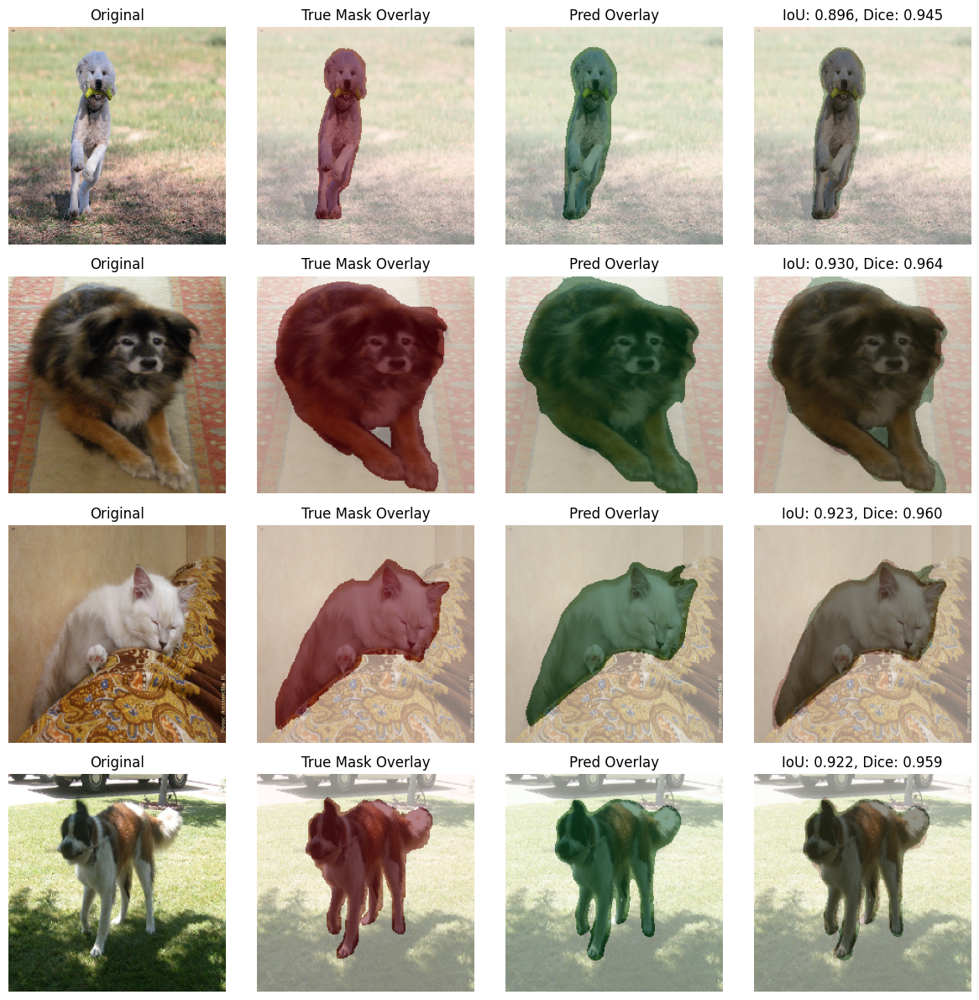

In [114]:
display_segmentation(model_seg_unet_ft, test_seg_loader)

## 2. Unet ++ with Resnet34 backbone

To improve segmentation performance, we use **U-Net++ with a ResNet34 backbone**.  
U-Net++ is an enhanced version of U-Net that introduces **nested and dense skip connections**, allowing better fusion of low-level spatial features and high-level semantic features. 
This structure is particularly beneficial for:
- Objects with varying sizes
- Complex boundaries
- High-resolution

The **ResNet34 encoder**, initialized with pretrained weights, provides strong feature extraction and faster convergence.

### Training Strategy
We train the model in two stages:
1. **Freeze the encoder**, train the decoder to adapt to pretrained features  
2. **Freeze the decoder**, fine-tune the encoder for the segmentation task

This approach improves stability and helps achieve higher segmentation accuracy compared to standard U-Net.


<img src="images/UNET.webp" width="1000">

In [64]:
model_seg_unetpp_ft = smp.UnetPlusPlus( encoder_name="resnet34", encoder_weights="imagenet", in_channels=3, classes=1).to(device)

In [ ]:
for param in model_seg_unetpp_ft.encoder.parameters():
    param.requires_grad = False
epochs = 4
lr = 5e-4
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model_seg_unetpp_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_unet(model_seg_unetpp_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)
for param in model_seg_unetpp_ft.decoder.parameters():
    param.requires_grad = False
lr = 2e-4
train_unet(model_seg_unetpp_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)

Epoch 4/4 Loss: 0.0771 Learning rate: 0.000500: 100%|██████████| 370/370 [02:22<00:00,  2.60it/s]


In [68]:
segmentation_results_pp = evaluate_segmentation(model_seg_unetpp_ft, test_seg_loader)
family_metrics_seg_pp = segmentation_results_pp.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg_pp = segmentation_results_pp.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()

100%|██████████| 93/93 [00:14<00:00,  6.57it/s]


In [65]:
#torch.save(model_seg_unetpp_ft.state_dict(), f"trained models/model_segmentation_unetpp_ft_lr_{lr}_epochs_{epochs}.pth")
model_seg_unetpp_ft.load_state_dict(torch.load("trained models/model_segmentation_unetpp_ft_lr_0.0002_epochs_4.pth"))

<All keys matched successfully>

In [86]:
show_table(family_metrics_seg_pp, "Family Segmentation Metrics")
show_table(breed_metrics_seg_pp, "Breed Segmentation Metrics")

We obtain the same results as Unet with Resnet34 backbone where the IoU is about 0.91 for both cat and dog.But a little bit different in the breed level where Samoyed, Keeshond are classified better than others(about 0.94 in IOU and 0.96 in Dice), meanwhile American bull dog, Bengal are classified worse than others (less than 0.88 in IOU and 0.93 in Dice). All of them are dogs, the reasons are similar to those discussed previously: certain dogs  have body shapes, coat patterns, or smaller sizes that make segmentation more challenging. But overall, the performance differences are relatively minor.

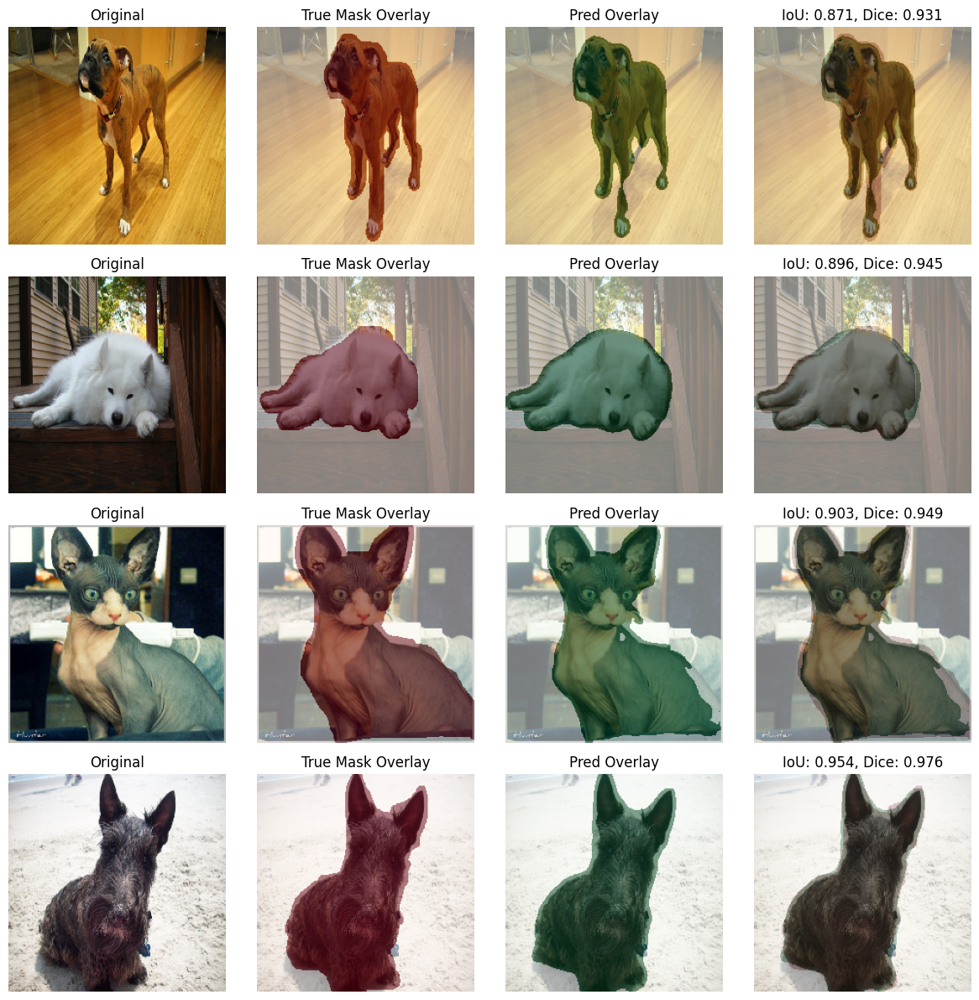

In [84]:
display_segmentation(model_seg_unetpp_ft, test_seg_loader)

<br/><br/><br/>

# IV. General analyse comparative

#### For the classification

In [47]:
breed_df_classification_cat = breed_df_classification[breed_df_classification['breed'].isin(cat_breeds)]
breed_df_classification_dog = breed_df_classification[breed_df_classification['breed'].isin(dog_breeds)]
breed_df_classification_dog.describe()

,f1_score,precision,recall,support
count,25.000000,25.000000,25.000000,25.000000
mean,0.897536,0.898028,0.902691,39.280000
std,0.092740,0.093835,0.111296,5.660683
min,0.655738,0.701754,0.596154,28.000000
25%,0.875000,0.820513,0.857143,36.000000
50%,0.923077,0.930233,0.944444,40.000000
75%,0.967742,0.975610,0.974359,42.000000
max,0.987013,1.000000,1.000000,52.000000


In [50]:
breed_df_classification_cat.describe()

,f1_score,precision,recall,support
count,12.000000,12.000000,12.000000,12.000000
mean,0.843156,0.869081,0.843246,41.333333
std,0.094282,0.081750,0.159232,7.126561
min,0.608696,0.711864,0.451613,31.000000
25%,0.796629,0.836124,0.774242,37.000000
50%,0.849759,0.904923,0.918786,40.500000
75%,0.916801,0.927265,0.943062,45.250000
max,0.962025,0.972222,1.000000,53.000000


By comparing the classification results, we observe that the average **F1-score**, **precision**, and **recall** for dog breed classification are slightly higher than those for cat breed classification. Specifically, dogs achieve higher scores in precision (0.89 vs. 0.86), recall (0.90 vs. 0.84), and F1-score (0.88 vs. 0.84).

This suggests that the model performs marginally better at identifying dog breeds than cat breeds. One possible explanation is that dog images may exhibit more distinctive visual features or patterns that the model can more easily learn, leading to improved classification performance. Additionally, the larger number of dog images in the dataset may contribute to better generalization for dog breeds.

Overall, while the model demonstrates strong performance for both cat and dog breed classification tasks, the slight performance advantage for dogs indicates that certain characteristics of dog breeds are more readily captured by the model.


#### For the segmentation

In [78]:
family_metrics_seg = pd.DataFrame({
    'family': ['cat', 'dog'],
    'scratch_iou_mean': family_metrics_seg_scratch['iou']['mean'],
    'ft_iou_mean': family_metrics_seg_ft['iou']['mean'],
    'unetpp_ft_iou_mean': family_metrics_seg_pp['iou']['mean'],
    'scratch_dice_mean': family_metrics_seg_scratch['dice']['mean'],
    'ft_dice_mean': family_metrics_seg_ft['dice']['mean'],
    'unetpp_ft_dice_mean': family_metrics_seg_pp['dice']['mean'],
})

In [81]:
breed_metrics_seg = pd.DataFrame({
    'breed': breed_metrics_seg_scratch['label'],
    'scratch_iou_mean': breed_metrics_seg_scratch['iou']['mean'],
    'ft_iou_mean': breed_metrics_seg_ft['iou']['mean'],
    'unetpp_ft_iou_mean': breed_metrics_seg_pp['iou']['mean'],
    'scratch_dice_mean': breed_metrics_seg_scratch['dice']['mean'],
    'ft_dice_mean': breed_metrics_seg_ft['dice']['mean'],
    'unetpp_ft_dice_mean': breed_metrics_seg_pp['dice']['mean'],
})

In [87]:
family_metrics_seg

,family,scratch_iou_mean,ft_iou_mean,unetpp_ft_iou_mean,scratch_dice_mean,ft_dice_mean,unetpp_ft_dice_mean
0,cat,0.644423,0.918907,0.911275,0.766112,0.956771,0.952156
1,dog,0.683042,0.909355,0.909858,0.796204,0.950258,0.950613


In [88]:
breed_metrics_seg

,breed,scratch_iou_mean,ft_iou_mean,unetpp_ft_iou_mean,scratch_dice_mean,ft_dice_mean,unetpp_ft_dice_mean
0,Abyssinian,0.560034,0.910365,0.891324,0.697859,0.952562,0.939889
1,Bengal,0.601473,0.893326,0.884576,0.721413,0.940889,0.934670
2,Birman,0.720727,0.918900,0.915393,0.830810,0.957208,0.955333
3,Bombay,0.639158,0.937953,0.930129,0.754626,0.967580,0.963074
4,British Shorthair,0.675655,0.926135,0.916620,0.795186,0.960277,0.954910
5,Egyptian Mau,0.561394,0.902255,0.898300,0.700127,0.947914,0.945819
6,Maine Coon,0.698483,0.926132,0.925015,0.809248,0.961242,0.960619
7,Persian,0.703983,0.936755,0.937149,0.813235,0.966764,0.967071
8,Ragdoll,0.681614,0.919783,0.916509,0.801714,0.957569,0.955722
9,Russian Blue,0.657411,0.931194,0.920930,0.773545,0.963624,0.957411


- Model comparison

Compared with the model trained from scratch: The UNet++ segmentation model shows a dramatique improvement, achieving mean IoU scores of ~0.90 for both cats and dogs and mean Dice coefficients of ~0.94–0.95, compared to ~0.64–0.68 IoU and ~0.76–0.79 Dice for the baseline model. Performance is now highly consistent across breeds, with most achieving IoU above 0.85. Previously challenging breeds such as Sphynx, Miniature Pinscher, and Abyssinian show substantial gains (IoU increasing from ~0.50–0.57 to ~0.86–0.89). The significantly reduce standard deviations indicate much more stable and reliable segmentation, with only rare failure cases likely caused by extreme poses or occlusions.

Compared with U-Net using a ResNet-34 backbone: Both models achieve excelent and very similar performance, with mean IoU around 0.90 and Dice around 0.94 for both cats and dogs. Differences at the breed level are minimal, and both models perform well on most breeds while struggling with the same difficult cases. The ResNet-34 backbone shows slightly better consistency and marginally stronger worst-case performance for some breeds, but overall accuracy is comparable. As both models deliver near production-level segmentation quality, the choice between them should be guided by computational efficiency or inference speed rather than accuracy.


Breed-Level Segmentation Performance Analysis

- Performance Distribution

From scratch training shows that cats achieve a mean IoU of 0.644 while dogs reach 0.683. The best performing cat breeds are Birman (0.721), Persian (0.704), and Maine Coon (0.698). The worst are Sphynx (0.535), Abyssinian (0.560), and Egyptian Mau (0.561), giving cats a performance spread of 0.187 IoU. For dogs, the top performers are Keeshond (0.843), Havanese (0.790), and Wheaten Terrier (0.773), while the bottom includes Miniature Pinscher (0.522), Pomeranian (0.596), and Boxer (0.600). Dogs show much higher variance with a 0.321 IoU spread.

After fine-tuning with ResNet-34, cats improve to 0.919 mean IoU with the best breeds being Bombay (0.938), Persian (0.937), and Russian Blue (0.931). The worst performers are Bengal (0.893), Egyptian Mau (0.902), and Sphynx (0.909), reducing the spread to just 0.045 IoU. Dogs reach 0.909 mean IoU with Keeshond (0.941), Newfoundland (0.939), and Pug (0.934) at the top. The struggling breeds are Miniature Pinscher (0.861), Saint Bernard (0.867), and American Bulldog (0.887), maintaining a larger spread of 0.081 IoU even after fine-tuning.

- Factors Affecting Performance

High baseline performance strongly correlates with large body size, as seen with Keeshond, Newfoundland, Leonberger, and Great Pyrenees. Breeds with distinctive, uniform coats like Birman, Havanese, and Persian also perform well from scratch. Conversely, very small breeds struggle significantly, with Miniature Pinscher, Pomeranian, and Chihuahua all scoring below 0.62 IoU. Unusual physical features hurt performance, particularly the hairless Sphynx, while complex coat patterns like Egyptian Mau's spots and Abyssinian's ticked coat create boundary confusion.

The breeds that gain most from fine-tuning are precisely those that struggled initially. Sphynx improves by 0.374 IoU, Miniature Pinscher by 0.338, Abyssinian by 0.350, Egyptian Mau by 0.341, and Pomeranian by 0.318. Meanwhile, breeds already performing well show smaller improvements. Keeshond only gains 0.098 IoU since it started at 0.843, while Wheaten Terrier gains 0.131, Havanese 0.134, English Setter 0.171, and Japanese Chin 0.161. This demonstrates that fine-tuning effectively levels the playing field across physically diverse breeds.

- Overall Conclusions

Fine-tuning successfully equalizes performance across physically diverse breeds, bringing all breeds above 0.86 IoU regardless of starting point. Architecture choice between ResNet-34 and UNet++ matters minimally at this performance level, differing by only ±0.01 IoU on average. Physical size dominates scratch performance, with larger breeds substantially outperforming smaller ones before fine-tuning. All breeds ultimately reach production quality after fine-tuning, with remaining failures likely stemming from extreme occlusions, unusual poses, poor image quality, or annotation errors rather than fundamental model limitations.

Moving forward, development should focus on edge cases involving occlusions and rare poses rather than improving baseline accuracy. Optimization efforts should target inference speed over incremental accuracy gains. Ensemble methods should only be considered for critical applications where the marginal accuracy improvement justifies the computational cost. The current fine-tuned models already deliver reliable, production-ready segmentation across all 37 breeds.

<br/><br/><br/>

## 6. Multi-task: classification and segmentation  

We use our model for this multi-task. Our model consists an encoder with CNN backbone to extract features (we recommend ResNet34), a segmentation decoder (U-Net style) and a classification head (Linear layers). Segmentation decoder and Classification head share input given by the encoder 

In [32]:
multi_task_model = MultiTaskModel(num_classes=2).to(device)
torchinfo.summary(multi_task_model, (1,3,224,224))

Layer (type:depth-idx)                        Output Shape              Param #
MultiTaskModel                                [1, 2]                    --
├─ResNetEncoder: 1-1                          [1, 3, 224, 224]          --
│    └─Conv2d: 2-1                            [1, 64, 112, 112]         9,408
│    └─BatchNorm2d: 2-2                       [1, 64, 112, 112]         128
│    └─ReLU: 2-3                              [1, 64, 112, 112]         --
│    └─MaxPool2d: 2-4                         [1, 64, 56, 56]           --
│    └─Sequential: 2-5                        [1, 64, 56, 56]           --
│    │    └─BasicBlock: 3-1                   [1, 64, 56, 56]           73,984
│    │    └─BasicBlock: 3-2                   [1, 64, 56, 56]           73,984
│    │    └─BasicBlock: 3-3                   [1, 64, 56, 56]           73,984
│    └─Sequential: 2-6                        [1, 128, 28, 28]          --
│    │    └─BasicBlock: 3-4                   [1, 128, 28, 28]          230,144

Then, we train this model by freezing encoder

In [122]:
train_multi_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn= custom_segmentation)
test_multi_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn= custom_segmentation)
for params in multi_task_model.encoder.parameters():
    params.requires_grad = False
epochs = 4
lr = 5e-4
criterion = ( nn.CrossEntropyLoss(),nn.BCEWithLogitsLoss())
optimizer = Adam(multi_task_model.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
catdog_num = {
    'cat' : 0,
    'dog' : 1
}
train_multimodel(multi_task_model, train_multi_loader, criterion, optimizer, scheduler, catdog_num,"catdog", epochs=epochs, lr=lr)


Epoch 1/4  Classification loss: 0.0063 Segmentation loss: 0.1347 Learning rate: 0.000500: 100%|██████████| 370/370 [00:59<00:00,  6.22it/s]
Epoch 2/4  Classification loss: 0.0066 Segmentation loss: 0.1098 Learning rate: 0.000500: 100%|██████████| 370/370 [00:58<00:00,  6.29it/s]
Epoch 3/4  Classification loss: 0.0154 Segmentation loss: 0.0799 Learning rate: 0.000500: 100%|██████████| 370/370 [00:58<00:00,  6.31it/s]
Epoch 4/4  Classification loss: 0.6835 Segmentation loss: 0.1535 Learning rate: 0.000500: 100%|██████████| 370/370 [00:58<00:00,  6.31it/s]


In [33]:
#torch.save(multi_task_model.state_dict(), f"trained models/model_multitask_lr_{lr}_epochs_{epochs}.pth")
multi_task_model.load_state_dict(torch.load("trained models/model_multitask_lr_0.0005_epochs_4.pth"))


<All keys matched successfully>

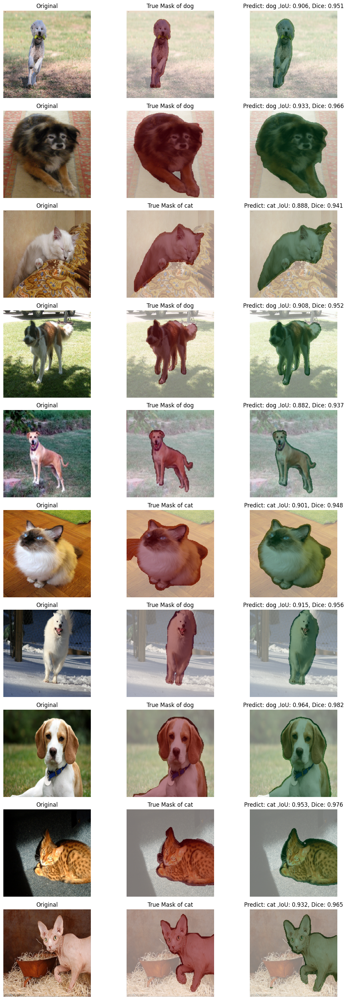

In [124]:
num_catdog = {
    0: "cat",
    1: "dog"
}
display_multitask(multi_task_model, test_multi_loader,num_catdog,n_images=10,type = "catdog")

In [141]:
multi_results = multi_evaluation(multi_task_model, test_multi_loader, catdog_num)

100%|██████████| 93/93 [00:11<00:00,  8.22it/s]


OVERALL METRICS
**************************************************
Total samples: 1478
IoU mean: 0.9024279713630676
IoU std: 0.0827038511633873
Dice mean: 0.9458985924720764
Dice std: 0.0671689435839653
Classification accuracy: 0.9953
PER-CLASS METRICS
**************************************************
               iou                         dice                     
              mean     std  min     max    mean     std  min     max
True label                                                          
0           0.8981  0.1019  0.0  0.9900  0.9418  0.0865  0.0  0.9950
1           0.9046  0.0711  0.0  0.9905  0.9479  0.0549  0.0  0.9953
MISCLASSIFICATION ANALYSIS
**************************************************
Misclassified count: 7
Misclassified IoU mean: 0.8562446236610413
Misclassified Dice mean: 0.918432354927063


- The multi-task model achieves exceptional performance on both tasks, with classification accuracy of 99.53% (misclassifying only 7 out of 1,478 samples) and segmentation performance nearly identical to the standalone segmentation models (IoU: 0.90, Dice: 0.95). 
- Compared to the standalone classification model which achieved 97% accuracy, the multi-task model shows a +2.5% improvement, suggesting that learning segmentation features helps the model better discriminate between cats and dogs by forcing it to understand precise object boundaries and morphology. 
- The segmentation quality matches the dedicated UNet models (IoU ~0.90 for both cats and dogs), indicating no performance degradation from the multi-task learning approach—in fact, the shared feature extraction between tasks appears mutually beneficial.
- Interestingly, the 7 misclassified samples still achieve reasonably good segmentation (IoU: 0.86, Dice: 0.92), demonstrating that the model can accurately segment an animal even when it incorrectly classifies its species, which suggests the misclassifications stem from high-level semantic confusion rather than failures in low-level feature detection. 
- This multi-task approach offers significant practical advantages: it delivers both outputs in a single forward pass (more efficient than running separate models), achieves better classification accuracy than the standalone classifier, and maintains segmentation quality comparable to dedicated segmentation networks, making it the optimal choice for applications requiring both cat/dog identification and precise object localization.